<a href="https://colab.research.google.com/github/sanketgawali123/-NETFLIX-MOVIES-AND-TV-SHOWS-CLUSTERING/blob/main/Netflix_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement

This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.

## In this project, you are required to do
Exploratory Data Analysis

Understanding what type content is available in different countries

Is Netflix has increasingly focusing on TV rather than movies in recent years.

Clustering similar content by matching text-based features

# Attribute Information

1.show_id : Unique ID for every Movie / Tv Show

2.type : Identifier - A Movie or TV Show

3.title : Title of the Movie / Tv Show

4.director : Director of the Movie

5.cast : Actors involved in the movie / show

6.country : Country where the movie / show was produced

7.date_added : Date it was added on Netflix

8.release_year : Actual Releaseyear of the movie / show

9.rating : TV Rating of the movie / show

10.duration : Total Duration - in minutes or number of seasons

11.listed_in : Genere

12.description: The Summary description

### Mounting google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings 
warnings.filterwarnings('ignore')


import matplotlib.mlab as mlab
from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE
%matplotlib inline

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats

from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE

%matplotlib inline

In [ ]:
path = '/content/drive/MyDrive/Colab Notebooks/Capstone Project/Netflix Movies and TV Shows Clustering/NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv'
data = pd.read_csv(path)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


In [ ]:
data.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...


In [ ]:
data.tail()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
7782,s7783,Movie,Zozo,Josef Fares,"Imad Creidi, Antoinette Turk, Elias Gergi, Car...","Sweden, Czech Republic, United Kingdom, Denmar...","October 19, 2020",2005,TV-MA,99 min,"Dramas, International Movies",When Lebanon's Civil War deprives Zozo of his ...
7783,s7784,Movie,Zubaan,Mozez Singh,"Vicky Kaushal, Sarah-Jane Dias, Raaghav Chanan...",India,"March 2, 2019",2015,TV-14,111 min,"Dramas, International Movies, Music & Musicals",A scrappy but poor boy worms his way into a ty...
7784,s7785,Movie,Zulu Man in Japan,NaN,Nasty C,NaN,"September 25, 2020",2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast..."
7785,s7786,TV Show,Zumbo's Just Desserts,NaN,"Adriano Zumbo, Rachel Khoo",Australia,"October 31, 2020",2019,TV-PG,1 Season,"International TV Shows, Reality TV",Dessert wizard Adriano Zumbo looks for the nex...
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,NaN,"United Kingdom, Canada, United States","March 1, 2020",2019,TV-MA,90 min,"Documentaries, Music & Musicals",This documentary delves into the mystique behi...


In [ ]:
data.shape

(7787, 12)

In [ ]:
data.columns

Index(['show_id', 'type', 'title', 'director', 'cast', 'country', 'date_added',
       'release_year', 'rating', 'duration', 'listed_in', 'description'],
      dtype='object')

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
release_year,7787.0,2013.93258,8.757395,1925.0,2013.0,2017.0,2018.0,2021.0


In [ ]:
data.describe(include = 'O').T

,count,unique,top,freq
show_id,7787,7787,s1,1
type,7787,2,Movie,5377
title,7787,7787,3%,1
director,5398,4049,"Raúl Campos, Jan Suter",18
cast,7069,6831,David Attenborough,18
country,7280,681,United States,2555
date_added,7777,1565,"January 1, 2020",118
rating,7780,14,TV-MA,2863
duration,7787,216,1 Season,1608
listed_in,7787,492,Documentaries,334


In [ ]:
data.isna().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

In [ ]:
from pandas.core.resample import date_range
# Handling Missing Value
data['director'].fillna('unknown', inplace = True)
data['cast'].fillna('unknown', inplace = True)
data['country'].fillna('nuknown', inplace = True)
data['date_added'].fillna('unknown', inplace = True)
data['rating'].fillna('unknown', inplace = True)

In [ ]:
import datetime as dt

In [ ]:
def date(row):
    a = row['date_added']
    if 'unknown' not in a:
        month = a.split()[0]
        year = a.split()[-1]
        day = a.split()[1].split(',')[0]
        a = dt.datetime.strptime(f'{month[:3]} {day} {year}', '%b %d %Y')
        return a
    else:
        return np.nan

data['date_added'] = data.apply(lambda x: date(x), axis = 1)

### Feaature ENGINEERING LISTED_IN

Genres are extracted and re-defined accordingly. TV and Movie genres are separately defined. These are combined. Topics like International TV Shows are removed as it could bring in a bias by displaying content in reference to American movies.

In [ ]:
netflix = data.copy()

In [ ]:
netflix['listed_in'] = netflix.listed_in.apply(lambda row: row.split(', '))
netflix.explode('listed_in')['listed_in'].unique()

array(['International TV Shows', 'TV Dramas', 'TV Sci-Fi & Fantasy',
       'Dramas', 'International Movies', 'Horror Movies',
       'Action & Adventure', 'Independent Movies', 'Sci-Fi & Fantasy',
       'TV Mysteries', 'Thrillers', 'Crime TV Shows', 'Docuseries',
       'Documentaries', 'Sports Movies', 'Comedies', 'Anime Series',
       'Reality TV', 'TV Comedies', 'Romantic Movies',
       'Romantic TV Shows', 'Science & Nature TV', 'Movies',
       'British TV Shows', 'Korean TV Shows', 'Music & Musicals',
       'LGBTQ Movies', 'Faith & Spirituality', "Kids' TV",
       'TV Action & Adventure', 'Spanish-Language TV Shows',
       'Children & Family Movies', 'TV Shows', 'Classic Movies',
       'Cult Movies', 'TV Horror', 'Stand-Up Comedy & Talk Shows',
       'Teen TV Shows', 'Stand-Up Comedy', 'Anime Features',
       'TV Thrillers', 'Classic & Cult TV'], dtype=object)

In [ ]:
replacing_genre = {'International TV Shows': '-',
                   'TV Dramas': 'Drama',
                   'TV Sci-Fi & Fantasy': 'SciFiFantasy',
                   'Dramas': 'Drama' ,
                   'International Movies': '-',
                   'Horror Movies': 'Horror',
                   'Action & Adventure': 'ActionAdventure',
                   'Independent Movies': '-',
                   'Sci-Fi & Fantasy': 'SciFiFantasy',
                   'TV Mysteries': 'Mystery',
                   'Thrillers': 'Thriller',
                   'Crime TV Shows': 'Crime',
                   'Docuseries': 'Documentary',
                   'Documentaries': 'Documentary', 'Sports Movies': 'Sports',
                   'Comedies':'Comedy',
                   'Anime Series': 'Anime',
                   'Reality TV': 'Reality',
                   'TV Comedies': 'Comedy',
                   'Romantic Movies': 'Romance',
                   'Romantic TV Shows': 'Romance',
                   'Science & Nature TV': 'Science',
                   'Movies': '-',
                   'British TV Shows': '-',
                   'Korean TV Shows': '-',
                   'Music & Musicals': 'Music',
                   'LGBTQ Movies': 'LGBTQ',
                   'Faith & Spirituality': 'Spirituality',
                   "Kids' TV": 'Kids',
                   'TV Action & Adventure': 'ActionAdventure',
                   'Spanish-Language TV Shows': '-',
                   'Children & Family Movies': 'Family',
                   'TV Shows': '-',
                   'Classic Movies': 'Classic',
                   'Cult Movies': 'Cult',
                   'TV Horror': 'Horror',
                   'Stand-Up Comedy & Talk Shows':'Comedy, TalkShow',
                   'Teen TV Shows': 'Teen', 'Stand-Up Comedy':'Comedy',
                   'Anime Features':'Anime',
                   'TV Thrillers': 'Thriller',
                   'Classic & Cult TV':'Classic, Cult'}

In [ ]:
def genre_replace(row, replacing_genre = replacing_genre):
    new_text = []
    for word in (row['listed_in']):
        if word in replacing_genre:
            if '-' not in replacing_genre[word]:
                new_text.append(replacing_genre[word])
        else:
            print(word, 'not presentin dictionary') 
    return(', '.join(new_text)) 

data['Genres'] = netflix.apply(lambda row: genre_replace(row), axis=1)
data['Genres'] = data['Genres'].apply(lambda row: row.split(', '))

In [ ]:
data.explode('Genres')['Genres'].unique()

array(['Drama', 'SciFiFantasy', 'Horror', 'ActionAdventure', 'Mystery',
       'Thriller', 'Crime', 'Documentary', 'Sports', 'Comedy', 'Anime',
       'Reality', 'Romance', 'Science', '', 'Music', 'LGBTQ',
       'Spirituality', 'Kids', 'Family', 'Classic', 'Cult', 'TalkShow',
       'Teen'], dtype=object)

In [ ]:
data['Genres']

0                 [Drama, SciFiFantasy]
1                               [Drama]
2                              [Horror]
3       [ActionAdventure, SciFiFantasy]
4                               [Drama]
                     ...               
7782                            [Drama]
7783                     [Drama, Music]
7784               [Documentary, Music]
7785                          [Reality]
7786               [Documentary, Music]
Name: Genres, Length: 7787, dtype: object

In [ ]:
def combine(row):
    text = ' '.join(row['Genres']).lower()
    if row['cast'] != 'unknown':
        cast_list = [actor.replace(' ', '') for actor in row['cast'].split(', ')]
        if len(cast_list) < 5:
            text = text + ' ' + ' '.join(cast_list[:]).lower()
        else :
            text = text + ' ' + ' '.join(cast_list[:5]).lower()
    if row['director'] !='unknown':
        director_list = ' '.join([director.replace(' ', '') for director in row['director'].split(', ')])
        text = text + ' ' + director_list.lower()
    return text

data['Movie Deets'] = data.apply(lambda row: combine(row), axis = 1)

In [ ]:
#importing necessary libraries for text processing
import nltk 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

### WORD TOKENIZATION

Tokenization breaks the raw text into words, sentences called tokens. These tokens help in understanding the context or developing the model for the NLP. The tokenization helps in interpreting the meaning of the text by analyzing the sequence of the words.

In [ ]:
import string

In [ ]:
def tokenizer(txt):
    tokens = word_tokenize(txt)
    return tokens
data['Processed Description'] = data['description'].apply(tokenizer)
data['Processed Movie Deets'] = data['Movie Deets'].apply(tokenizer)

### Punctuation Remove

In [ ]:
regular_punct = list(string.punctuation)
def remove_punctuation(text,punct_list):
    tokens = text
    new_tok = []
    for i in tokens:
        word = i
        for punctuation in list(string.punctuation):
            word = word.replace(punctuation, ' ')
        if word.replace(' ','').isalnum():
            new_tok.append(word)

    return ' '.join(new_tok).split(' ')

data['Processed Description'] = data['Processed Description'].apply(lambda x : remove_punctuation(x, regular_punct))
data['Processed Movie Deets'] = data['Processed Movie Deets'].apply(lambda x : remove_punctuation(x, regular_punct))

### Stop Word Removal

In [ ]:
stop_words = set(stopwords.words('english'))

def remove_stop(tokens, stopwords):
  return [t.lower() for t in tokens if t.lower() not in stopwords]

data['Processed Description'] = data['Processed Description'].apply(lambda x : remove_stop(x, stop_words))

netflix = data.copy()

### Stemming

In [ ]:
ps = PorterStemmer()

def stem_text(text):
  stemmed = []
  for word in text:
    stemmed.append(ps.stem(word))
  return stemmed

data['Processed Description'] = data['Processed Description'].apply(lambda x : stem_text(x))

In [ ]:
def joiner(text_list):
    new = []
    for text in text_list:
        if text == ' ' or text == '' :
            pass
        else:
            new.append(text)

    return ' '.join(new)

data['Processed Description'] = data['Processed Description'].apply(lambda x : joiner(x))
data['Processed Movie Deets'] = data['Processed Movie Deets'].apply(lambda x : joiner(x))

In [ ]:
data.loc[:,['description','Processed Description','Movie Deets','Processed Movie Deets']].head(1).T

,0
description,In a future where the elite inhabit an island ...
Processed Description,futur elit inhabit island paradis far crowd sl...
Movie Deets,drama scififantasy joãomiguel biancacomparato ...
Processed Movie Deets,drama scififantasy joãomiguel biancacomparato ...


In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [ ]:
count_vectorizer = CountVectorizer(min_df = 10,max_df=0.5)
count_description_vector = count_vectorizer.fit_transform(data['Processed Description'])
count_movie_vector = count_vectorizer.fit_transform(data['Processed Movie Deets'])

In [ ]:
count_description_vector.shape

(7787, 2126)

In [ ]:
count_movie_vector.shape

(7787, 192)

In [ ]:
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(pd.concat([pd.DataFrame(count_description_vector.todense()), pd.DataFrame(count_movie_vector.todense())],axis =1))

PCA()

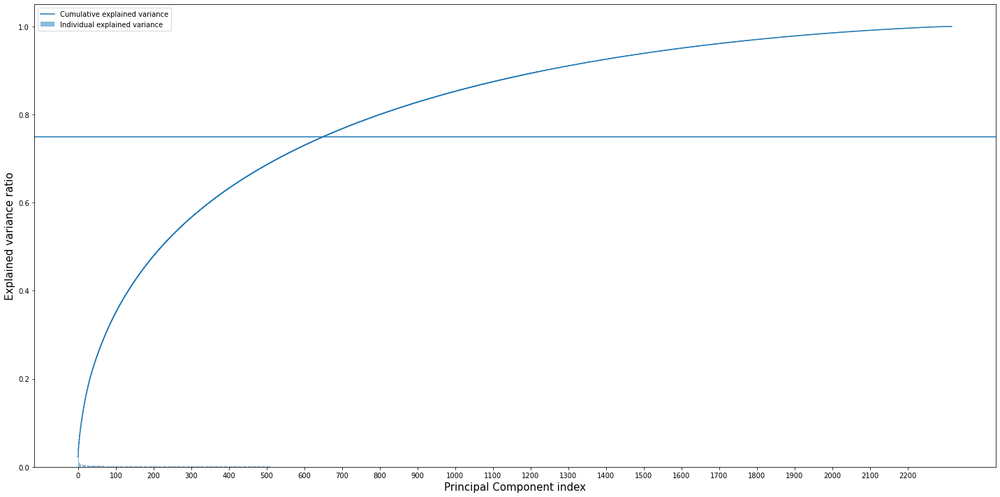

In [ ]:
exp_var_pca = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
plt.figure(figsize = (20,10))
plt.bar(range(0, len(exp_var_pca)), exp_var_pca, alpha = 0.5, align = 'center', label = 'Individual explained variance')
plt.step(range(0, len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where = 'mid', label = 'Cumulative explained variance')
plt.xlabel('Principal Component index', size = 15)
plt.ylabel('Explained variance ratio', size = 15)
plt.legend(loc = 'best')
plt.tight_layout()
plt.xticks(ticks = np.arange(0,2300,100))
plt.axhline(y = 0.75)
plt.show()

Vectorising the preprocessed attributes Movie Deets and Description has sum total of 2126 + 192 = 2318 dimensions. These dimensions will have to be reduced using PCA, which would result in loss of information. Alternatively, the two attributes can be used to model the content into topics using Latent Dirichlet Allocation. This would makes sure that all the topical information about video content are captured without putting any available information to waste.

### Bag of words wordcloud generation of content description based on genre

In [ ]:
from wordcloud import WordCloud

In [ ]:
genres = data.explode('Genres').Genres.unique()

In [ ]:
copy = netflix.explode('Genres').copy()
netflix = copy.copy()
netflix['Processed Description'] = netflix['Processed Description'].apply(lambda x : joiner(x))

In [ ]:
netflix = data.loc[:,['show_id','title','country','Genres']].copy()
netflix = netflix.explode('Genres')
genre_list = netflix.Genres.unique()
group = netflix.groupby('Genres').agg(count = ('show_id','count')).sort_values('count',ascending = False).reset_index()
#plt.figure(figsize=(15,10))
#_ = sns.barplot(y = 'Genres', x = 'count',data = group , palette='inferno')

In [ ]:
top15genres = group.head(15)['Genres'].to_list()

In [ ]:
netflix = copy.copy()
netflix['Processed Description'] = netflix['Processed Description'].apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

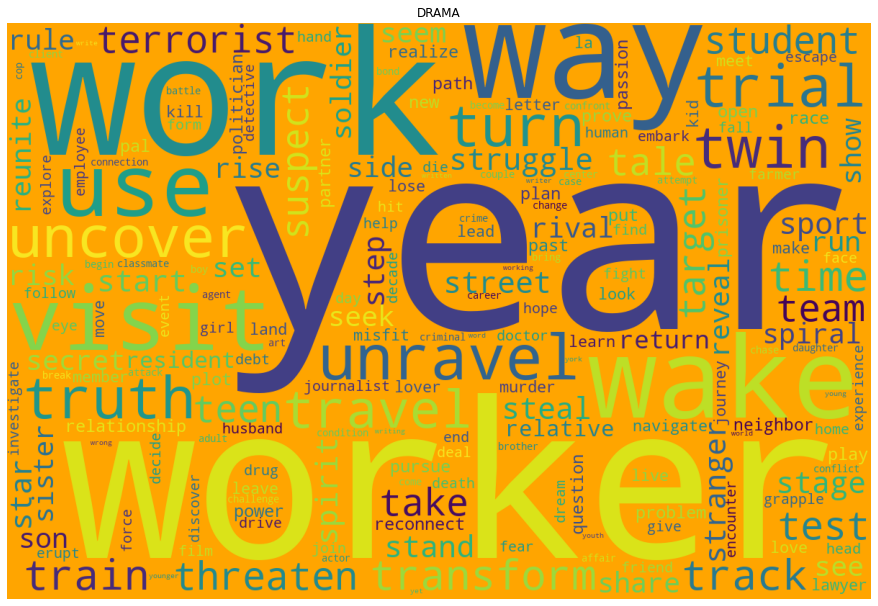

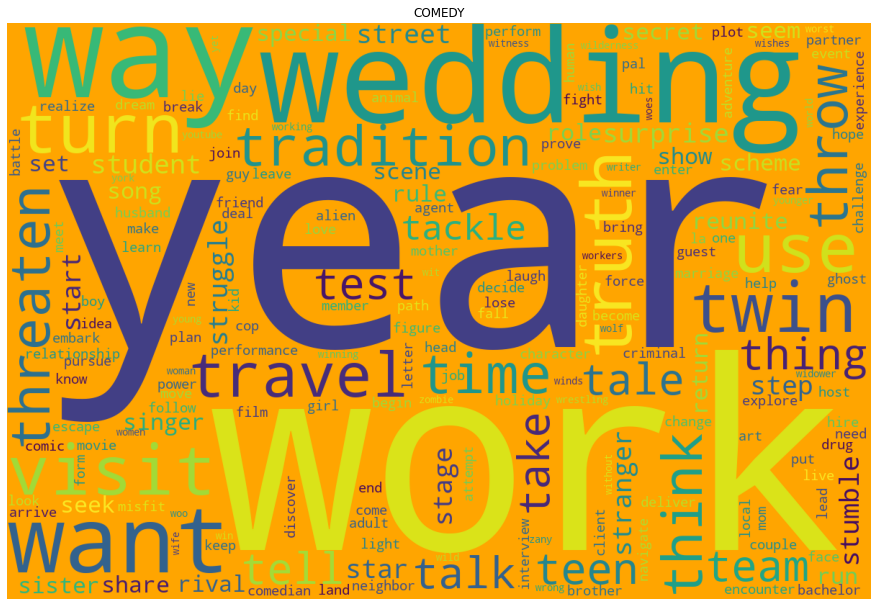

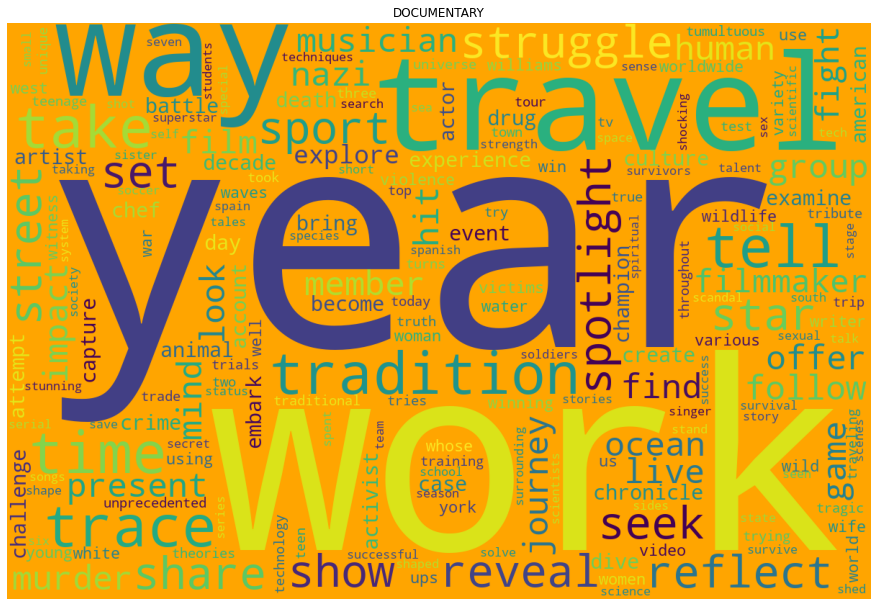

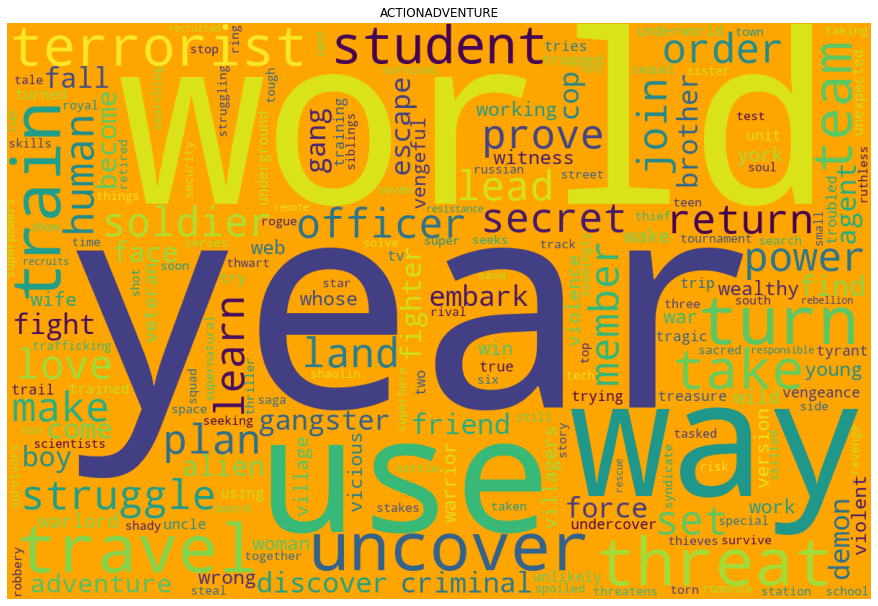

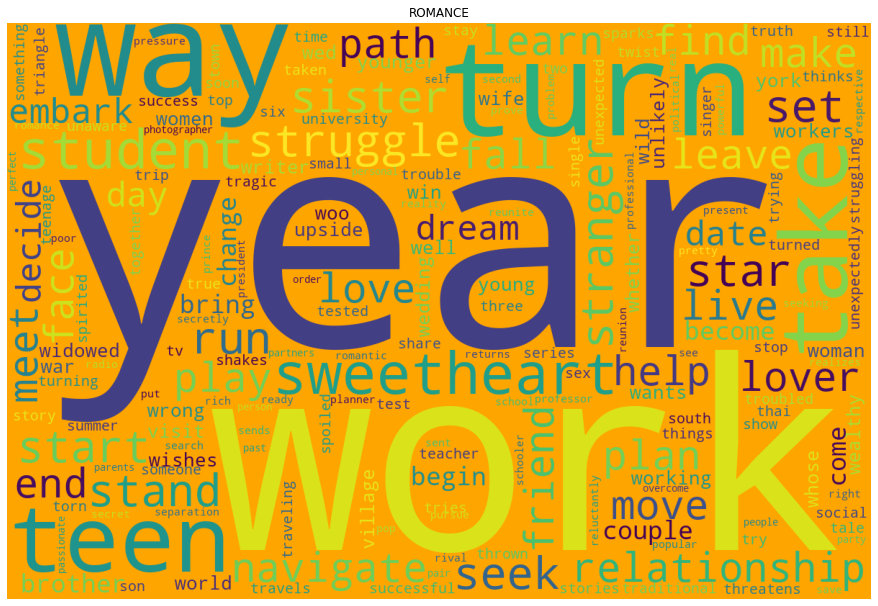

...

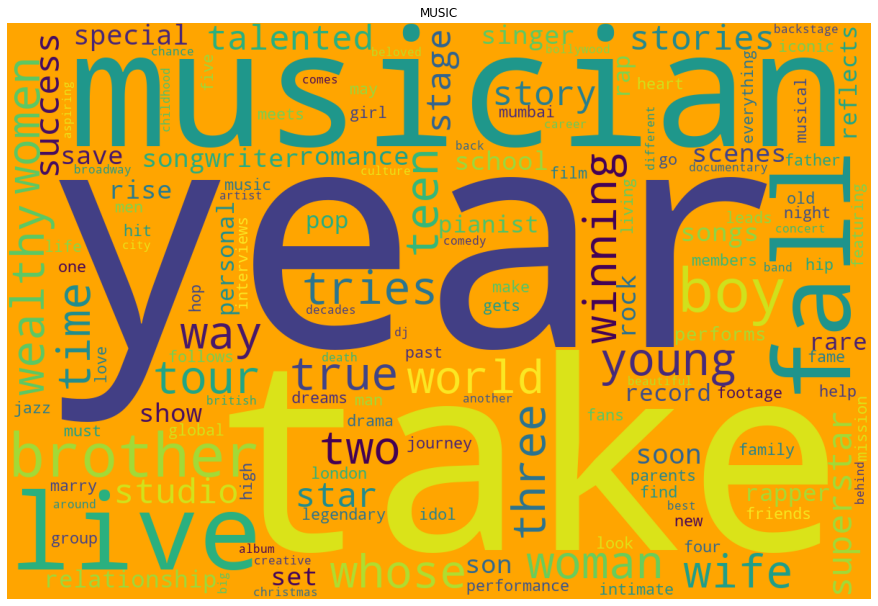

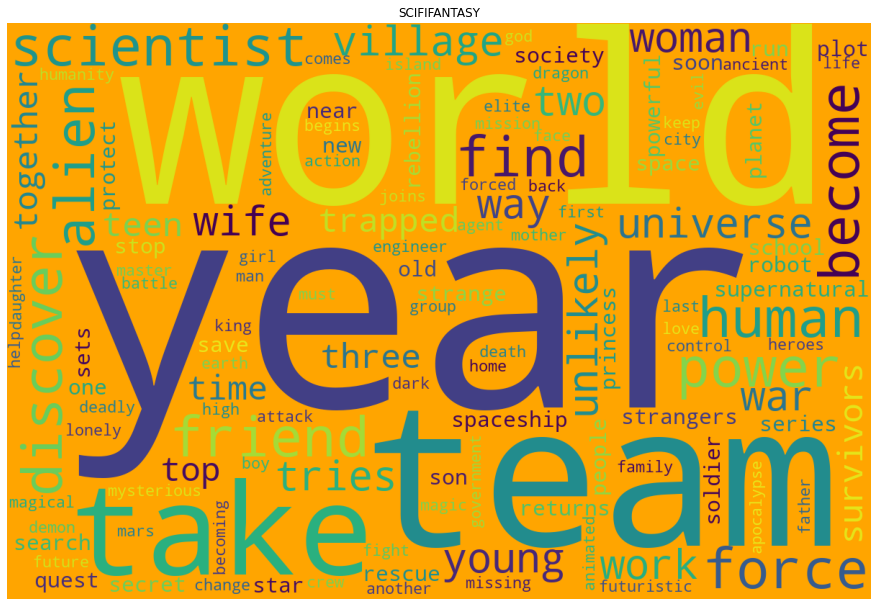

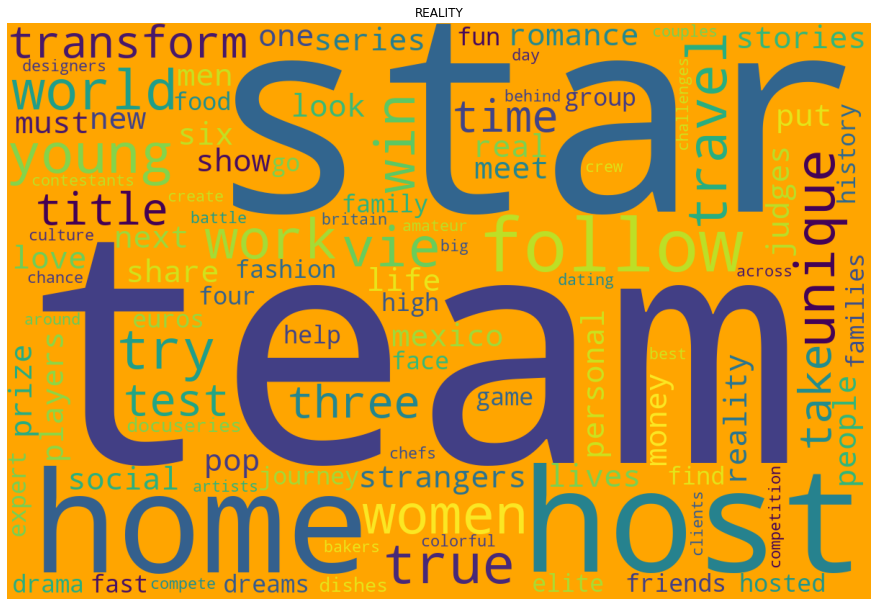

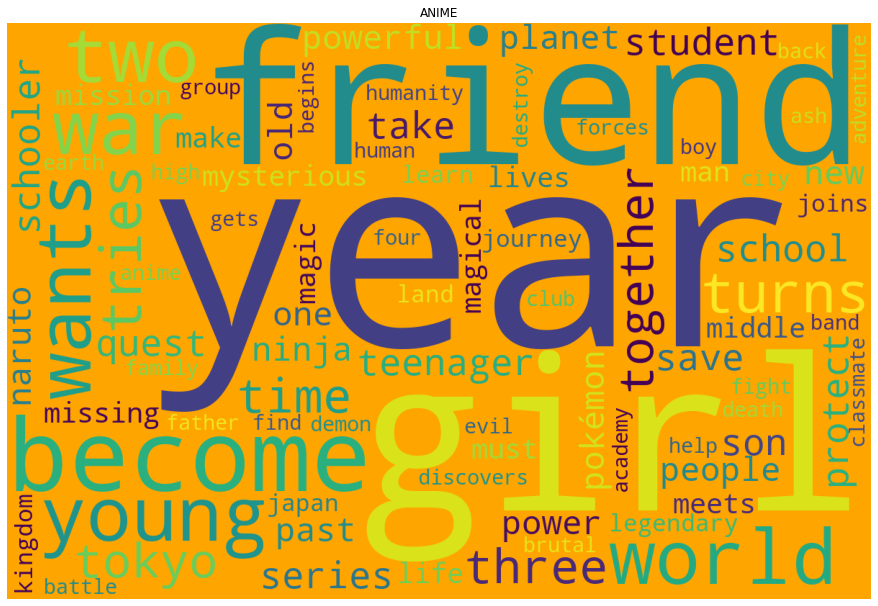

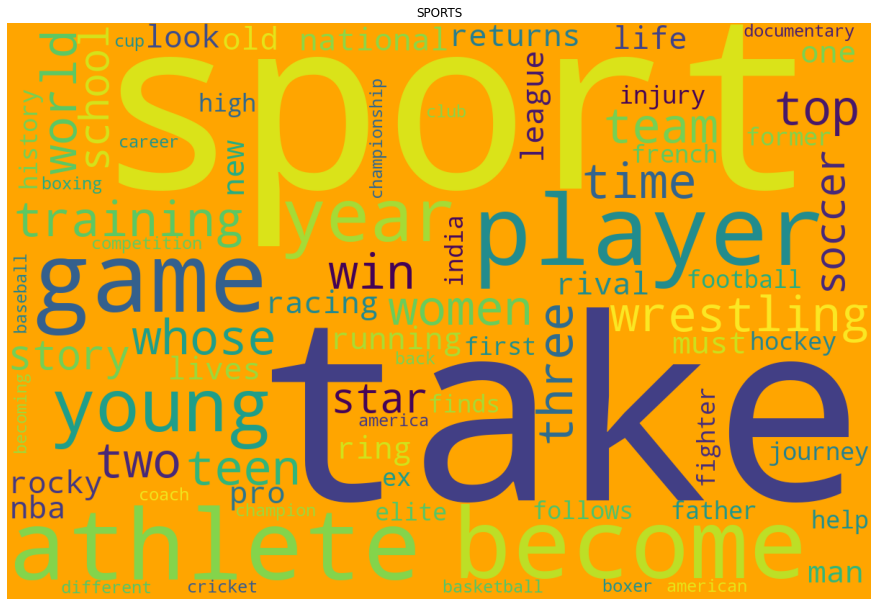

In [ ]:
#from numpy.lib.function_base import vectorize
plt.figure(figsize = (35,30))
plt.suptitle('Word Cloud for Different Genres', fontsize = 18, y = 0.5)
for genre in top15genres:
    if genre != '':
        count_description_vectorizer = CountVectorizer(ngram_range = (1,1), min_df = 5, max_df = 0.7)
        count_description_vectorizer.fit(netflix[netflix.Genres == genre]['Processed Description'])
        dictionary = count_description_vectorizer.vocabulary_.items()

        vocab = []
        count_of_vocab = []

        for key, value in dictionary:
            vocab.append(key)
            count_of_vocab.append(value)

        count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending = False)
        comment_words = ' '.join(count_description_df['Token'].to_list())

        wordcloud = WordCloud(width = 1200, height = 800,
                              background_color = 'Orange',
                              min_font_size = 10, random_state = 33).generate(comment_words)

        # plot the wordcloud image
        plt.figure(figsize = (12,8), facecolor = None)
        plt.imshow(wordcloud)
        plt.axis('off')
        plt.tight_layout(pad = 0)
        plt.title(genre.upper())
        plt.show()

In [ ]:
netflix = copy.copy()
netflix['Processed Description'] = netflix['Processed Description'].apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

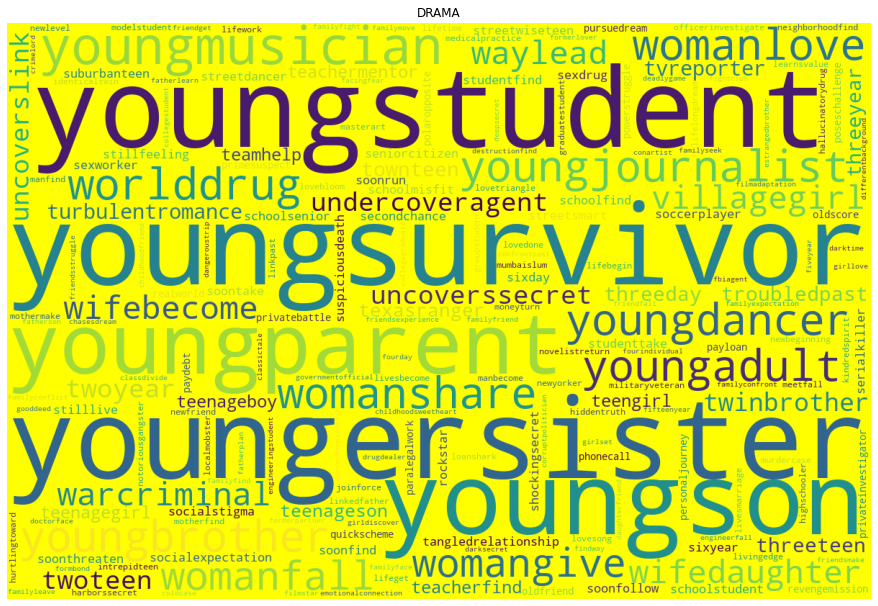

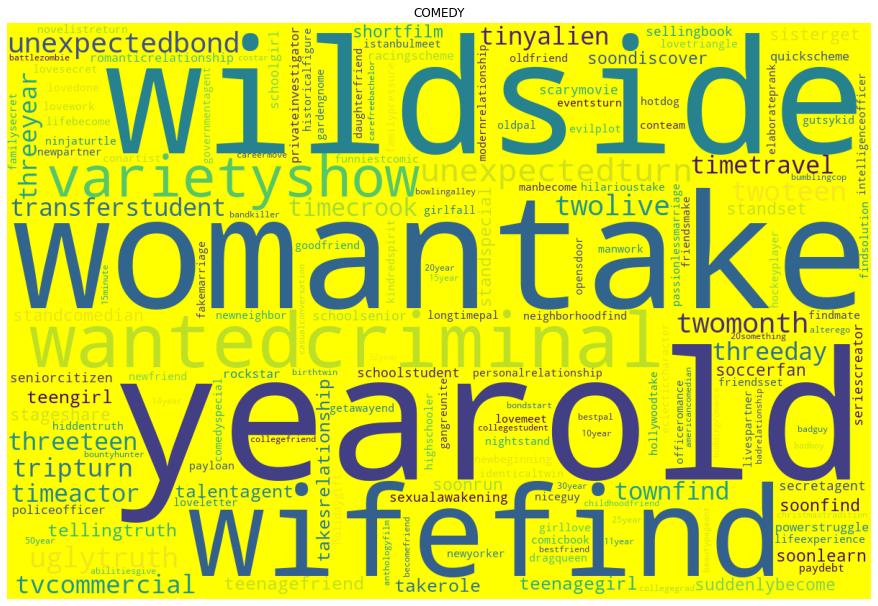

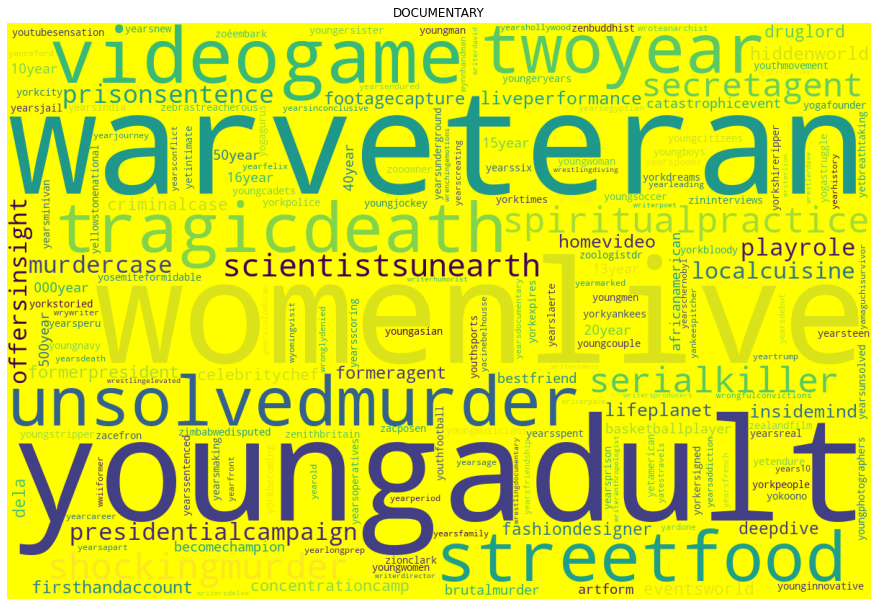

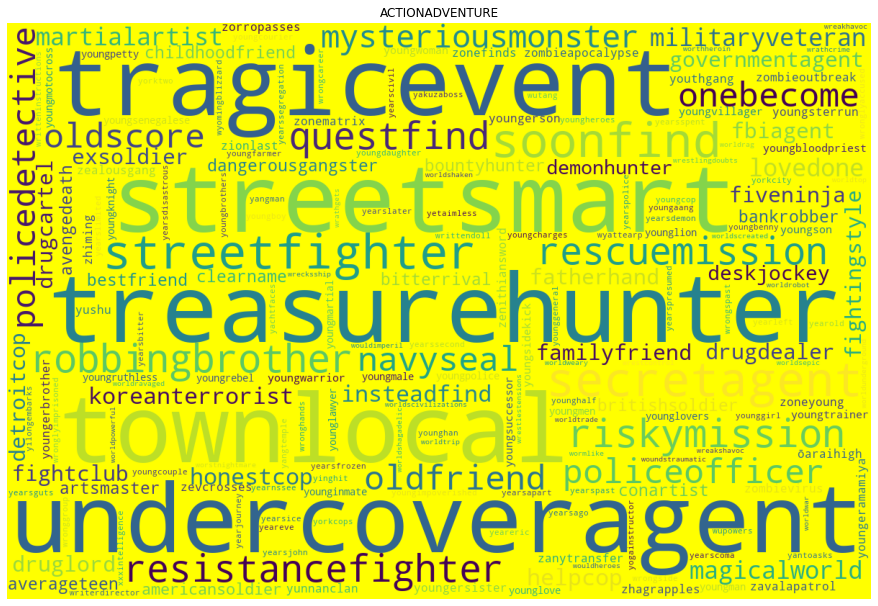

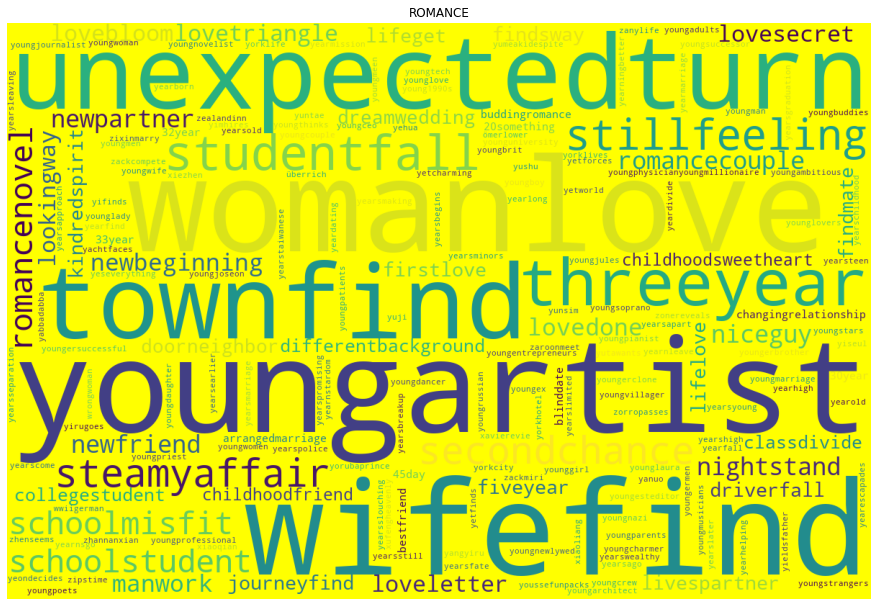

...

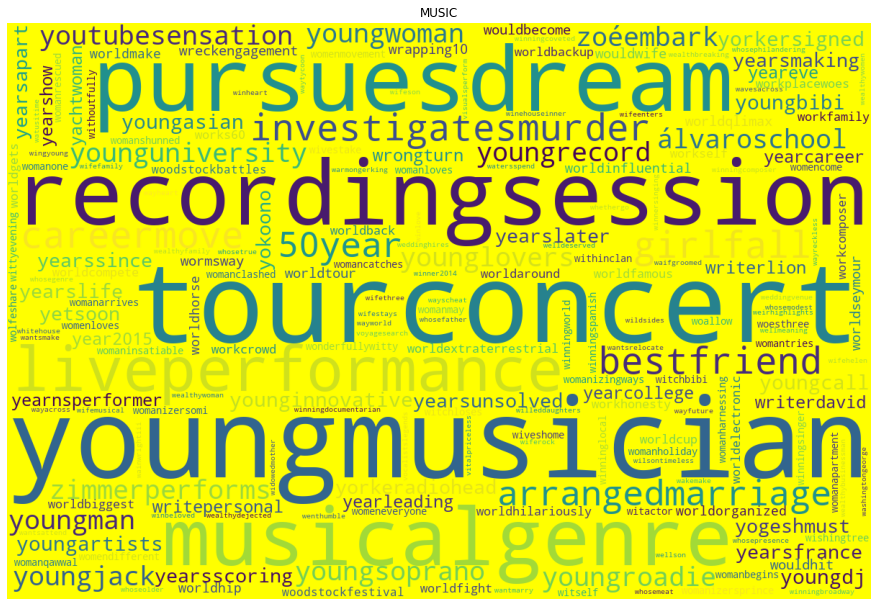

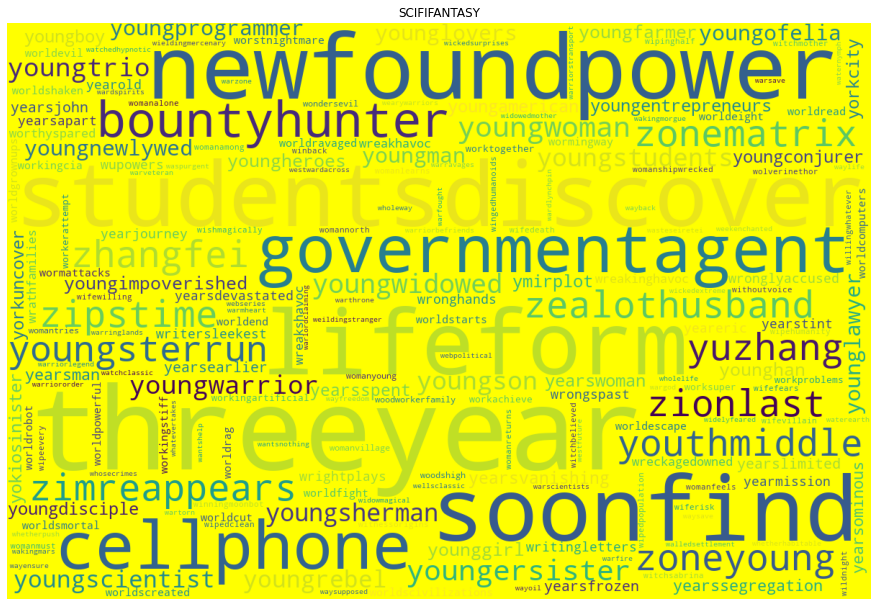

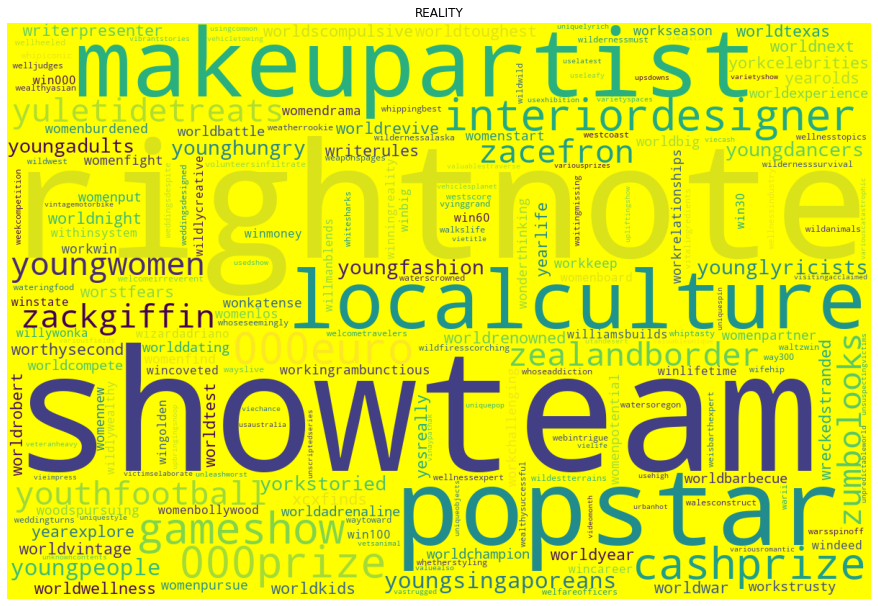

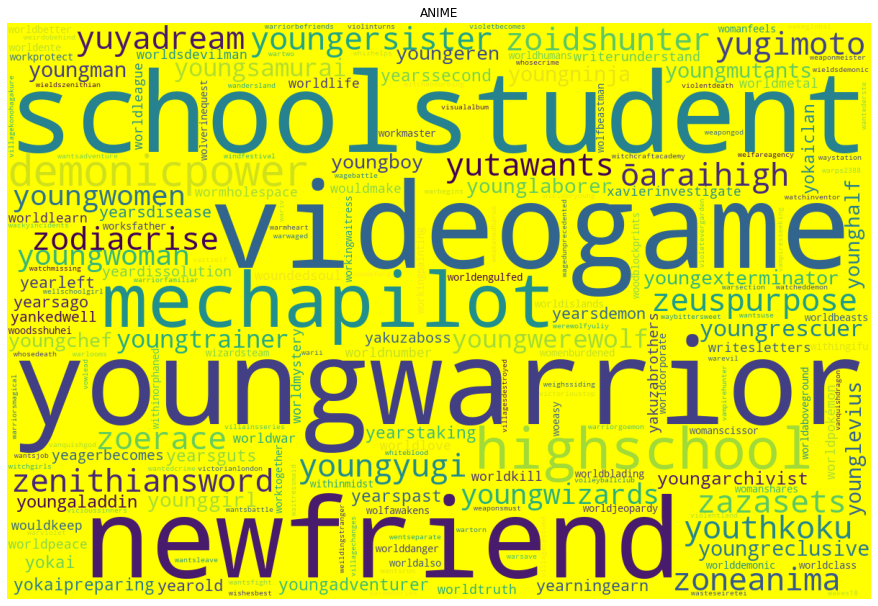

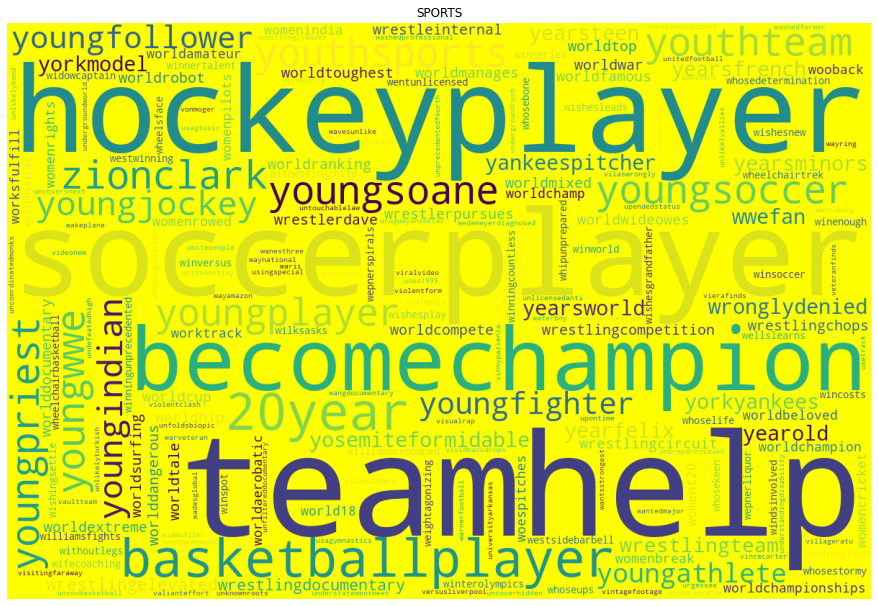

In [ ]:
plt.figure(figsize = (35,30))
plt.suptitle("Word Cloud for Different Genres", fontsize = 18, y = 0.5)

for genre in top15genres:
    if genre != '':
        count_description_vectorizer = CountVectorizer(ngram_range = (2,2), min_df = 1, max_df = 0.7)
        count_description_vectorizer.fit(netflix[netflix.Genres == genre]['Processed Description'])
        dictionary = count_description_vectorizer.vocabulary_.items()

        vocab = []
        count_of_vocab = []

        for key, value in dictionary:
            vocab.append(key)
            count_of_vocab.append(value)

        count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending = False)
        comment_words = ' '.join(count_description_df['Token'].apply(lambda row: ''.join(row.split(' '))).to_list())

        wordcloud = WordCloud(width = 1200, height = 800,
                        background_color ='yellow',
                        min_font_size = 10, random_state = 33).generate(comment_words)

        plt.figure(figsize = (12, 8), facecolor = None)
        plt.imshow(wordcloud)
        plt.axis("off")
        plt.tight_layout(pad = 0)
        plt.title(genre.upper())

        plt.show()

### Preparing dataset for clustering

In [ ]:
clustering_df = data[['type','duration','rating','release_year']]

In [ ]:
def topick(row):
    older_kids = ['TV-PG','PG','TV-Y7','TV-Y7-FV']
    kids = ['TV-G','G','TV-14']
    teen = ['PG-13','TV-14']
    adult = ['R','NC-17','TV-MA','UR','NR']

    rating = 'Others'
    for column in older_kids + kids + teen + adult:
        if row[column] == 1:
            if column in older_kids:
                rating = 'Older kids'
            elif column in teen:
                rating = 'Teens'
            elif column in adult:
                rating = 'Adults'
    return rating

rating = pd.get_dummies(clustering_df['rating']).drop('unknown',axis = 1).apply(lambda x: topick(x), axis = 1)

Encoding Type, Rating

In [ ]:
clustering_df = pd.concat([clustering_df.drop(['type','rating'], axis = 1),pd.get_dummies(rating).drop('Others', axis = 1), pd.get_dummies(clustering_df['type'])], axis = 1)

In [ ]:
clustering_df

,duration,release_year,Adults,Older kids,Teens,Movie,TV Show
0,4 Seasons,2020,1,0,0,0,1
1,93 min,2016,1,0,0,1,0
2,78 min,2011,1,0,0,1,0
3,80 min,2009,0,0,1,1,0
4,123 min,2008,0,0,1,1,0
...,...,...,...,...,...,...,...
7782,99 min,2005,1,0,0,1,0
7783,111 min,2015,0,0,1,1,0
7784,44 min,2019,1,0,0,1,0
7785,1 Season,2019,0,1,0,0,1


### Processing Movies Duration

In [ ]:
def duration(row, column):
    text = row['duration'].split()
    if column == 'show':
        if row['Movie'] == 0:
            return int(text[0])
        else:
            return 0
    
    if column == 'movie':
        if row['Movie'] == 1:
            return int(text[0])
        else:
            return 0

clustering_df['show_duration'] = clustering_df.apply(lambda x: duration(x, 'show'), axis = 1)
clustering_df['movie_duration'] = clustering_df.apply(lambda x:duration(x,'movie'),axis = 1)

Extracting season numbers and movie duration as separate columns

In [ ]:
clustering_df.drop('duration',axis = 1, inplace = True)

In [ ]:
(clustering_df['release_year']).unique()

array([2020, 2016, 2011, 2009, 2008, 2019, 1997, 2017, 2018, 2014, 2015,
       2010, 2005, 2013, 2012, 2006, 2000, 2003, 1989, 2004, 1977, 1971,
       1993, 2007, 1998, 1988, 1996, 2002, 1986, 1990, 1979, 1980, 1974,
       2001, 1999, 1966, 1991, 1982, 1994, 1995, 1978, 1992, 1972, 1975,
       2021, 1973, 1967, 1960, 1981, 1958, 1976, 1968, 1956, 1985, 1965,
       1984, 1983, 1987, 1945, 1946, 1962, 1925, 1942, 1969, 1955, 1963,
       1964, 1954, 1970, 1944, 1947, 1959, 1943])

In [ ]:
def bin_release_year(row):
    r_year = row['release_year']
    for yr in np.arange(2030,1910-10):
        if r_year >= yr:
            return (yr)

clustering_df['released_year_bins'] = (clustering_df.apply(lambda x: bin_release_year(x), axis = 1))

In [ ]:
clustering_df

,release_year,Adults,Older kids,Teens,Movie,TV Show,released_year_bins,show_duration,movie_duration
0,2020,1,0,0,0,1,None,4,0
1,2016,1,0,0,1,0,None,0,93
2,2011,1,0,0,1,0,None,0,78
3,2009,0,0,1,1,0,None,0,80
4,2008,0,0,1,1,0,None,0,123
...,...,...,...,...,...,...,...,...,...
7782,2005,1,0,0,1,0,None,0,99
7783,2015,0,0,1,1,0,None,0,111
7784,2019,1,0,0,1,0,None,0,44
7785,2019,0,1,0,0,1,None,1,0


In [ ]:
import matplotlib.cm as cm
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import linear_kernel
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics

from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.cluster import DBSCAN, AffinityPropagation
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder

### Topic Modeling using Gensim

In [ ]:
topic_input = data['Processed Description'] + ' ' + data['Processed Movie Deets']

In [ ]:
from gensim.models.ldamulticore import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel

In [ ]:
from gensim.corpora import Dictionary
gensim_paragraphs = (topic_input).apply(lambda row: row.split(' '))
dict_gensim_para = Dictionary(gensim_paragraphs)
dict_gensim_para.filter_extremes(no_below = 5, no_above = 0.6)
bow_gensim_para = [dict_gensim_para.doc2bow(paragraph) for paragraph in gensim_paragraphs]

In [ ]:
from gensim.models import TfidfModel
tfidf_gensim_para = TfidfModel(bow_gensim_para)
vector_gensim_para = tfidf_gensim_para[bow_gensim_para]

In [ ]:
lda_para_model_n = []
for n in (range(5, 16)):
    lda_model = LdaMulticore(corpus=bow_gensim_para, id2word=dict_gensim_para,
                                chunksize=1000, eta='auto', iterations=400,
                                num_topics=n, passes=20, eval_every=None,
                                random_state=42)
    lda_coherence = CoherenceModel(model=lda_model, texts=gensim_paragraphs,
                                dictionary=dict_gensim_para, coherence='c_npmi') 
    print(n,'|', lda_coherence.get_coherence())
    lda_para_model_n.append((n, lda_model, lda_coherence.get_coherence()))

5 | -0.005675361387931286
6 | 0.014222793752022173
7 | 0.011370027410632482
8 | 0.008047417027411467
9 | 0.02082203733396503
10 | 0.013706304968136249
11 | 0.001915275116751191
12 | 0.016653360978463334
13 | 0.009614431281682738
14 | -0.0011204275967704445
15 | -0.01749408946399412


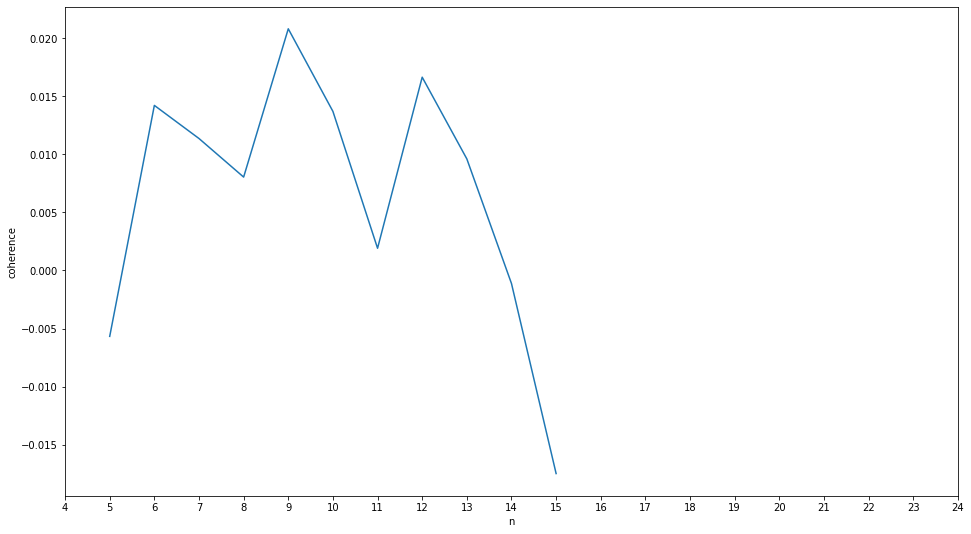

In [ ]:
lda_df = pd.DataFrame(lda_para_model_n, columns=["n", "model", "coherence"]).set_index("n")[["coherence"]]
plt.figure(figsize=(16,9))
_ = sns.lineplot(x='n', y='coherence', data=lda_df )
_ = plt.xticks(ticks = np.arange(4,25,1))

In [ ]:
lda_df = lda_df.reset_index()
topic_nums = lda_df[lda_df['coherence']==lda_df['coherence'].max()]['n'].to_list()[0]
topic_nums

9

In [ ]:
lda_gensim_para = LdaMulticore(corpus=bow_gensim_para,
                               id2word=dict_gensim_para,
                               chunksize=2000, eta='auto', iterations=400,
                               num_topics= topic_nums , passes=20,
                               eval_every=None,random_state=42)

In [ ]:
# display gensim topics
def display_gensim_topics(model):
    gen_list = lda_gensim_para.print_topics()
    for i in range(0,len(gen_list)):
        print('Topic: ',i+1,'\\n')
        topics = gen_list[i][1]
        for j in topics.split('+'):
            print(j.split('\"')[1])

        print("------\\n")
display_gensim_topics(lda_gensim_para)

Topic:  1 \n
drama
comedy
romance
famili
life
find
young
live
man
woman
------\n
Topic:  2 \n
drama
horror
thriller
young
famili
begin
mysteri
life
find
woman
------\n
Topic:  3 \n
actionadventure
scififantasy
drama
anime
world
kids
power
save
fight
team
------\n
Topic:  4 \n
comedy
school
drama
high
family
teen
student
new
world
friend
------\n
Topic:  5 \n
crime
drama
actionadventure
thriller
murder
cop
investig
polic
drug
detect
------\n
Topic:  6 \n
documentary
documentari
music
seri
stori
world
explor
film
life
histori
------\n
Topic:  7 \n
comedy
drama
romance
life
find
year
love
new
friend
get
------\n
Topic:  8 \n
drama
comedy
romance
love
famili
young
man
woman
fall
life
------\n
Topic:  9 \n
comedy
kids
family
friend
special
stand
comedi
comedian
show
take
------\n


In [ ]:
pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pyLDAvis
import pyLDAvis.gensim_models

In [ ]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim_models.prepare(lda_gensim_para, bow_gensim_para, dict_gensim_para)
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8     -0.163881  0.076358       1        1  13.103302
7      0.084525  0.047686       2        1  12.994531
5     -0.210906 -0.050261       3        1  12.576976
6      0.047927  0.118408       4        1  12.018592
4      0.093994 -0.156624       5        1  11.148771
2     -0.026510 -0.164505       6        1  10.954532
1      0.099708  0.013472       7        1   9.545361
3     -0.021289  0.084177       8        1   9.283971
0      0.096432  0.031289       9        1   8.373964, topic_info=                Term         Freq        Total Category  logprob  loglift
171      documentary  1047.000000  1047.000000  Default  30.0000  30.0000
158            crime   574.000000   574.000000  Default  29.0000  29.0000
241           comedy  2282.000000  2282.000000  Default  28.0000  28.0000
48   actionadventure   813.000000   813.000000  Default  27.0000  27.0000
3              drama  2883.000000  2883.000000  Default  26.0000  26.0000
..               ...          ...          ...      ...      ...      ...
272              two    37.953737   443.226702   Topic9  -5.5818   0.0223
63             becom    35.565167   365.114207   Topic9  -5.6468   0.1512
113              new    37.510755   624.375124   Topic9  -5.5936  -0.3321
543              set    34.147321   252.439019   Topic9  -5.6875   0.4796
48   actionadventure    34.449662   813.418951   Topic9  -5.6787  -0.6817

[695 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
557       1  0.951237       100
736       6  0.953976        18
3557      4  0.916195        25
3019      1  0.184964        30
3019      4  0.813843        30
...     ...       ...       ...
238       7  0.202064     young
238       8  0.063888     young
238       9  0.108461     young
3948      2  0.979322        yu
2817      6  0.925473  yukikaji

[1907 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[9, 8, 6, 7, 5, 3, 2, 4, 1])

In [ ]:
lda = {}
for i in range(0, lda_gensim_para.num_topics):
    lda[f'Topic {i}'] = np.zeros(data.shape[0])

In [ ]:
for i, row in enumerate(lda_gensim_para[bow_gensim_para]):
    for topic in row:
        lda[f'Topic {topic[0]}'][i] = topic[1]

In [ ]:
topic_model_df = pd.DataFrame(lda)

In [ ]:
topic_model_df

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8
0,0.00000,0.000000,0.603337,0.000000,0.000000,0.000000,0.000000,0.350877,0.000000
1,0.00000,0.000000,0.262647,0.000000,0.000000,0.000000,0.484132,0.000000,0.216167
2,0.00000,0.456893,0.407709,0.098354,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.00000,0.222019,0.403173,0.000000,0.127537,0.000000,0.000000,0.000000,0.216401
4,0.00000,0.607669,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.349100
...,...,...,...,...,...,...,...,...,...
7782,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.925890,0.000000
7783,0.18483,0.000000,0.000000,0.000000,0.000000,0.000000,0.094618,0.605640,0.085656
7784,0.00000,0.000000,0.078378,0.000000,0.000000,0.875852,0.000000,0.000000,0.000000
7785,0.20938,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.735044


In [ ]:
def topic_input(row):
    highest = 0
    top = 'None'
    for topic in topic_model_df.columns:
        if row[topic] > highest:
            highest = row[topic]
            top = f'Topic {int(topic[-1])+1}'
    return top

topic = topic_model_df.apply(lambda x:topic_input(x),axis=1)

In [ ]:
netflix = copy.copy()
netflix['Processed Description'] = netflix['Processed Description'] .apply(lambda x : joiner(x))
netflix = pd.concat([netflix, pd.DataFrame(topic, columns = ['Topic'])], axis = 1)

<Figure size 2520x2160 with 0 Axes>

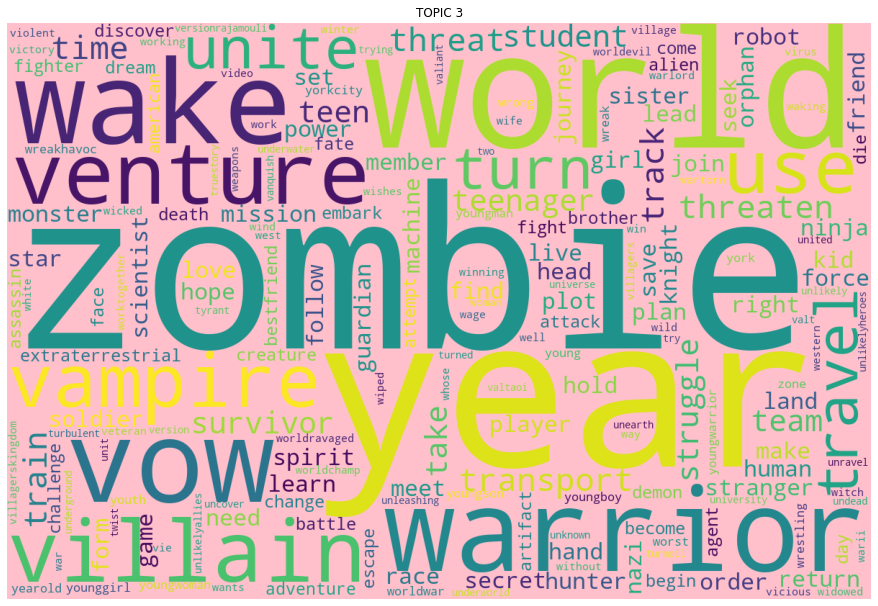

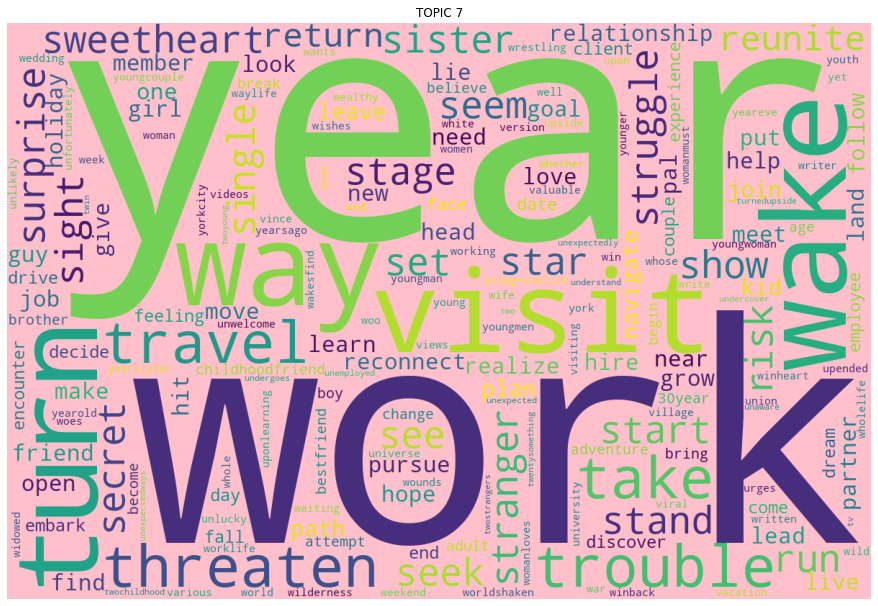

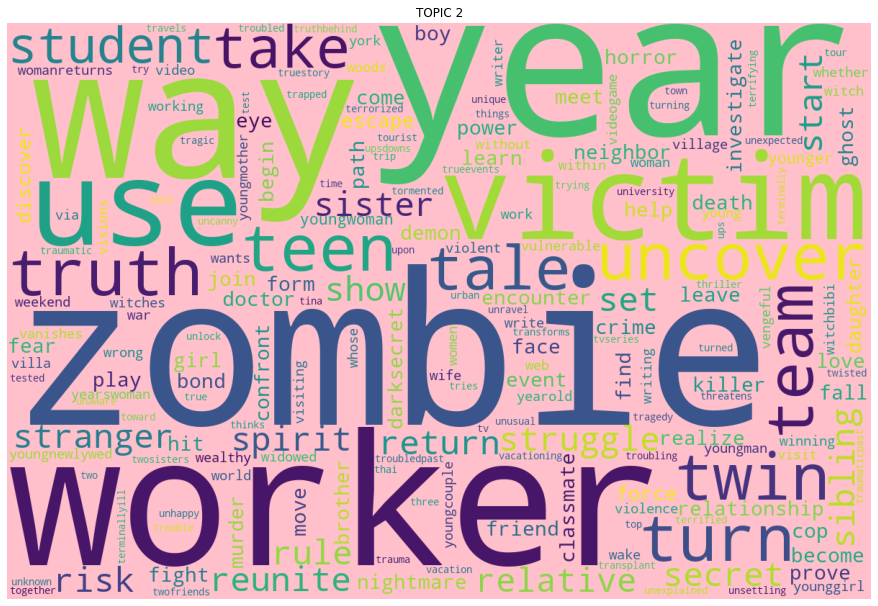

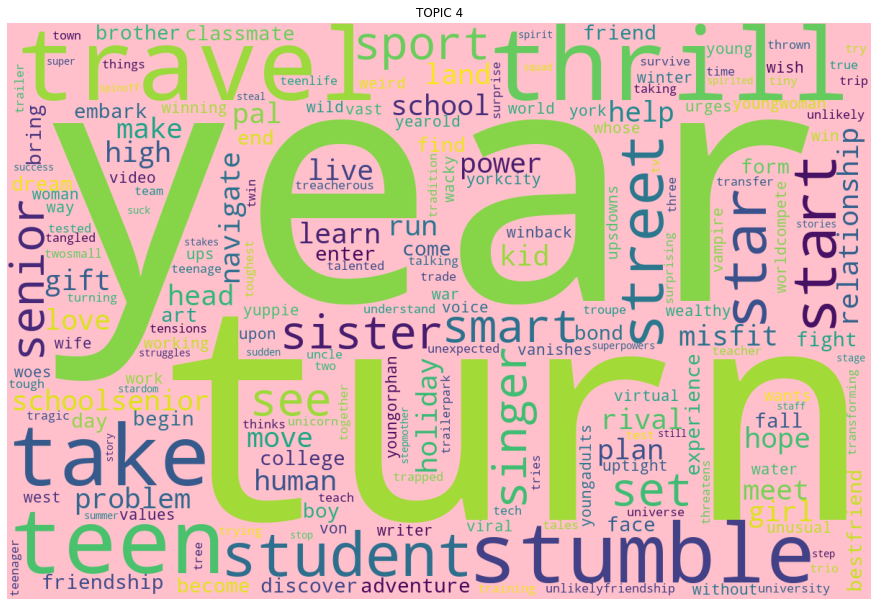

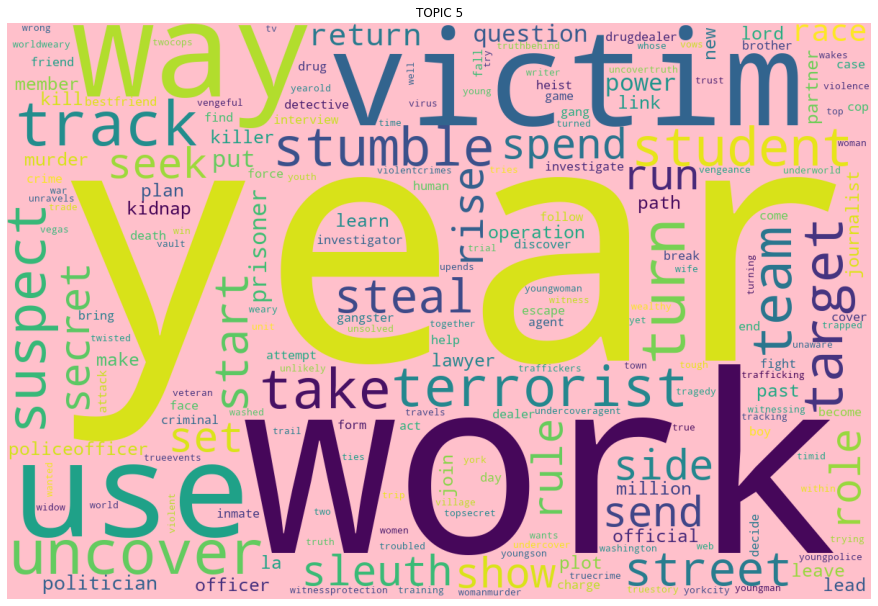

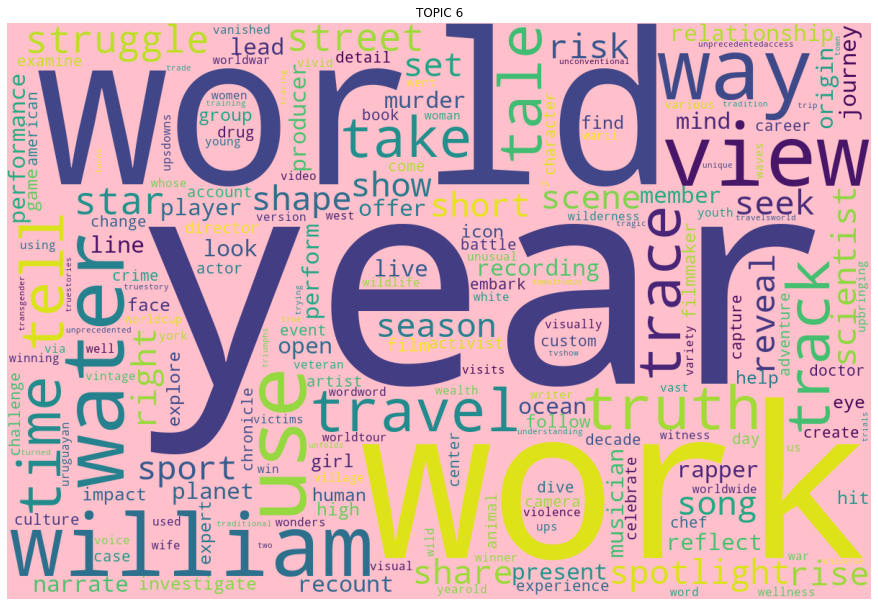

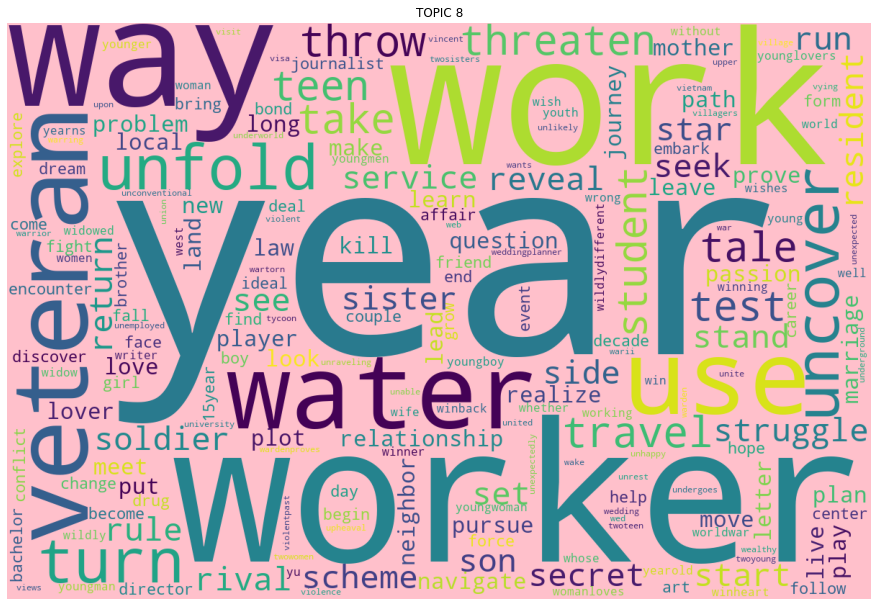

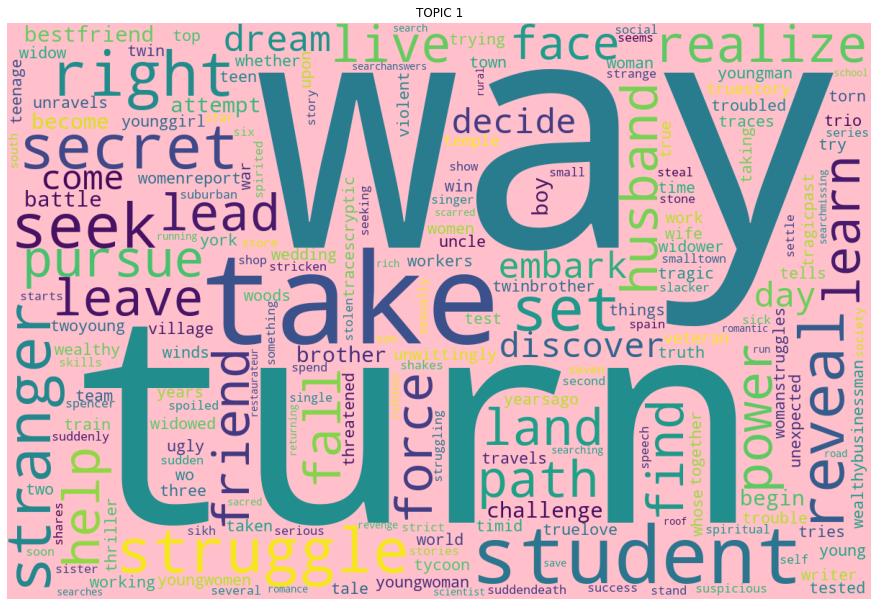

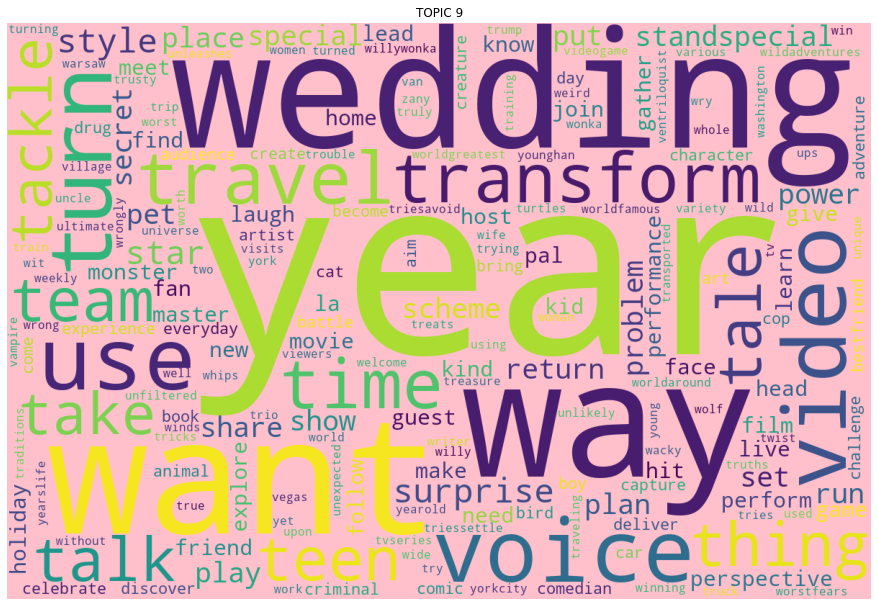

In [ ]:
plt.figure(figsize = (35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize = 18, y = 0.5)

for top in topic.unique():
    count_description_vectorizer = CountVectorizer(ngram_range = (1,2), min_df = 5, max_df = 0.7)
    count_description_vectorizer.fit(netflix[netflix['Topic'] == top]['Processed Description'])
    dictionary = count_description_vectorizer.vocabulary_.items()
    vocab = []
    count_of_vocab = []

    for key, value in dictionary:
        vocab.append(key)
        count_of_vocab.append(value)

    count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending = False)
    comment_words = ' '.join(count_description_df['Token'].apply(lambda row: ''.join(row.split(' '))).to_list())

    wordcloud = WordCloud(width = 1200, height = 800,
                          background_color ='pink',
                          min_font_size = 10).generate(comment_words)
    # plot the WordCloud image
    plt.figure(figsize = (12, 8), facecolor = None)
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(top.upper())
    plt.show()

### Concatenating clustering_df with topic models

In [ ]:
clustering_df

,release_year,Adults,Older kids,Teens,Movie,TV Show,released_year_bins,show_duration,movie_duration
0,2020,1,0,0,0,1,None,4,0
1,2016,1,0,0,1,0,None,0,93
2,2011,1,0,0,1,0,None,0,78
3,2009,0,0,1,1,0,None,0,80
4,2008,0,0,1,1,0,None,0,123
...,...,...,...,...,...,...,...,...,...
7782,2005,1,0,0,1,0,None,0,99
7783,2015,0,0,1,1,0,None,0,111
7784,2019,1,0,0,1,0,None,0,44
7785,2019,0,1,0,0,1,None,1,0


### Scaling

In [ ]:
vectorizer_clustering = pd.concat([clustering_df.drop(['release_year'], axis = 1),], axis = 1)

In [ ]:
vectorizer_clustering

,Adults,Older kids,Teens,Movie,TV Show,released_year_bins,show_duration,movie_duration
0,1,0,0,0,1,None,4,0
1,1,0,0,1,0,None,0,93
2,1,0,0,1,0,None,0,78
3,0,0,1,1,0,None,0,80
4,0,0,1,1,0,None,0,123
...,...,...,...,...,...,...,...,...
7782,1,0,0,1,0,None,0,99
7783,0,0,1,1,0,None,0,111
7784,1,0,0,1,0,None,0,44
7785,0,1,0,0,1,None,1,0


In [ ]:
scaler = MinMaxScaler()
X_rescale = scaler.fit_transform(vectorizer_clustering)
X = pd.concat([pd.DataFrame(X_rescale, columns = vectorizer_clustering.columns), (topic_model_df)], axis = 1)

In [ ]:
X

,Adults,Older kids,Teens,Movie,TV Show,released_year_bins,show_duration,movie_duration,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8
0,1.0,0.0,0.0,0.0,1.0,NaN,0.2500,0.000000,0.00000,0.000000,0.603337,0.000000,0.000000,0.000000,0.000000,0.350877,0.000000
1,1.0,0.0,0.0,1.0,0.0,NaN,0.0000,0.298077,0.00000,0.000000,0.262647,0.000000,0.000000,0.000000,0.484132,0.000000,0.216167
2,1.0,0.0,0.0,1.0,0.0,NaN,0.0000,0.250000,0.00000,0.456893,0.407709,0.098354,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.0,0.0,1.0,1.0,0.0,NaN,0.0000,0.256410,0.00000,0.222019,0.403173,0.000000,0.127537,0.000000,0.000000,0.000000,0.216401
4,0.0,0.0,1.0,1.0,0.0,NaN,0.0000,0.394231,0.00000,0.607669,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.349100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7782,1.0,0.0,0.0,1.0,0.0,NaN,0.0000,0.317308,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.925890,0.000000
7783,0.0,0.0,1.0,1.0,0.0,NaN,0.0000,0.355769,0.18483,0.000000,0.000000,0.000000,0.000000,0.000000,0.094618,0.605640,0.085656
7784,1.0,0.0,0.0,1.0,0.0,NaN,0.0000,0.141026,0.00000,0.000000,0.078378,0.000000,0.000000,0.875852,0.000000,0.000000,0.000000
7785,0.0,1.0,0.0,0.0,1.0,NaN,0.0625,0.000000,0.20938,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.735044


In [ ]:
X = X.to_numpy()

In [ ]:
X.shape

(7787, 17)

### renaming 'listed_in' column to 'genres'.

In [ ]:
#rename the column for sake of simplicity
netflix.rename(columns = {'listed_in':'genres'}, inplace = True)

In [ ]:
# Copying main dataframe for exploring genres
genres_explore = netflix.copy()

In [ ]:
genres_explore = pd.concat([genres_explore, netflix["genres"].str.split(",", expand = True)], axis = 1)

In [ ]:
#Check genres_explore
genres_explore

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,genres,description,Genres,Movie Deets,Processed Description,Processed Movie Deets,Topic,0,1,2
0,s1,TV Show,3%,unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,Drama,drama scififantasy joãomiguel biancacomparato ...,future elite inhabit island paradise far crowd...,"[drama, scififantasy, joãomiguel, biancacompar...",Topic 9,International TV Shows,TV Dramas,TV Sci-Fi & Fantasy
0,s1,TV Show,3%,unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,SciFiFantasy,drama scififantasy joãomiguel biancacomparato ...,future elite inhabit island paradise far crowd...,"[drama, scififantasy, joãomiguel, biancacompar...",Topic 9,International TV Shows,TV Dramas,TV Sci-Fi & Fantasy
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,Drama,drama demiánbichir héctorbonilla oscarserrano ...,devastating earthquake hits mexico city trappe...,"[drama, demiánbichir, héctorbonilla, oscarserr...",Topic 7,Dramas,International Movies,None
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",Horror,horror teddchan stellachung henleyhii lawrence...,army recruit found dead fellow soldiers forced...,"[horror, teddchan, stellachung, henleyhii, law...",Topic 3,Horror Movies,International Movies,None
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",ActionAdventure,actionadventure scififantasy elijahwood johnc....,postapocalyptic world rag doll robots hide fea...,"[actionadventure, scififantasy, elijahwood, jo...",Topic 3,Action & Adventure,Independent Movies,Sci-Fi & Fantasy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7784,s7785,Movie,Zulu Man in Japan,unknown,Nasty C,nuknown,2020-09-25,2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast...",Documentary,documentary music nastyc,documentary south african rapper nasty c hits ...,"[documentary, music, nastyc]",Topic 6,Documentaries,International Movies,Music & Musicals
7784,s7785,Movie,Zulu Man in Japan,unknown,Nasty C,nuknown,2020-09-25,2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast...",Music,documentary music nastyc,documentary south african rapper nasty c hits ...,"[documentary, music, nastyc]",Topic 6,Documentaries,International Movies,Music & Musicals
7785,s7786,TV Show,Zumbo's Just Desserts,unknown,"Adriano Zumbo, Rachel Khoo",Australia,2020-10-31,2019,TV-PG,1 Season,"International TV Shows, Reality TV",Dessert wizard Adriano Zumbo looks for the nex...,Reality,reality adrianozumbo rachelkhoo,dessert wizard adriano zumbo looks next willy ...,"[reality, adrianozumbo, rachelkhoo]",Topic 9,International TV Shows,Reality TV,None
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,unknown,"United Kingdom, Canada, United States",2020-03-01,2019,TV-MA,90 min,"Documentaries, Music & Musicals",This documentary delves into the mystique behi...,Documentary,documentary music samdunn,documentary delves mystique behind blues rock ...,"[documentary, music, samdunn]",Topic 6,Documentaries,Music & Musicals,None


In [ ]:
# Melting the required features
genres_explore = genres_explore.melt(id_vars = ['type','title'], value_vars=range(3),value_name="genres")
genres_explore = genres_explore[genres_explore['genres'].notna()]
genres_explore

,type,title,variable,genres
0,TV Show,3%,0,International TV Shows
1,TV Show,3%,0,International TV Shows
2,Movie,7:19,0,Dramas
3,Movie,23:59,0,Horror Movies
4,Movie,9,0,Action & Adventure
...,...,...,...,...
36943,Movie,Zoo,2,International Movies
36947,Movie,Zubaan,2,Music & Musicals
36948,Movie,Zubaan,2,Music & Musicals
36949,Movie,Zulu Man in Japan,2,Music & Musicals


In [ ]:
# counting top 30 genres by occurence
genres_explore['genres'].value_counts()[:30]

 International Movies       3599
Dramas                      2046
Comedies                    1895
 Dramas                     1569
Action & Adventure          1349
 TV Dramas                  1225
 Romantic Movies            1101
International TV Shows      1040
Documentaries                999
 Independent Movies          919
Children & Family Movies     900
 Comedies                    899
 TV Comedies                 841
 Thrillers                   827
 International TV Shows      726
Crime TV Shows               724
 Music & Musicals            636
 Romantic TV Shows           522
Kids' TV                     518
 Sci-Fi & Fantasy            478
 Sports Movies               418
Horror Movies                370
Stand-Up Comedy              321
British TV Shows             308
Docuseries                   290
 Docuseries                  282
 TV Action & Adventure       269
 TV Mysteries                233
Anime Series                 218
 TV Sci-Fi & Fantasy         200
Name: genr

In [ ]:
genres_explore['genres'] = genres_explore['genres'].str.strip()
genres_explore['genres'].value_counts()[:20]

International Movies        3736
Dramas                      3615
Comedies                    2794
International TV Shows      1766
Action & Adventure          1349
TV Dramas                   1330
Romantic Movies             1104
Documentaries               1074
TV Comedies                 1011
Children & Family Movies     978
Independent Movies           942
Thrillers                    876
Crime TV Shows               825
Music & Musicals             660
Kids' TV                     621
Romantic TV Shows            593
Docuseries                   572
Horror Movies                528
Sci-Fi & Fantasy             499
Sports Movies                419
Name: genres, dtype: int64

In [ ]:
# Creating a different country datframe
country_count = netflix.copy()
country_count = pd.concat([country_count, netflix['country'].str.split(",",expand = True)], axis = 1)
country_count

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,...,2,3,4,5,6,7,8,9,10,11
0,s1,TV Show,3%,unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,...,None,None,None,None,None,None,None,None,None,None
0,s1,TV Show,3%,unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,...,None,None,None,None,None,None,None,None,None,None
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,...,None,None,None,None,None,None,None,None,None,None
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,...,None,None,None,None,None,None,None,None,None,None
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7784,s7785,Movie,Zulu Man in Japan,unknown,Nasty C,nuknown,2020-09-25,2019,TV-MA,44 min,...,None,None,None,None,None,None,None,None,None,None
7784,s7785,Movie,Zulu Man in Japan,unknown,Nasty C,nuknown,2020-09-25,2019,TV-MA,44 min,...,None,None,None,None,None,None,None,None,None,None
7785,s7786,TV Show,Zumbo's Just Desserts,unknown,"Adriano Zumbo, Rachel Khoo",Australia,2020-10-31,2019,TV-PG,1 Season,...,None,None,None,None,None,None,None,None,None,None
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,unknown,"United Kingdom, Canada, United States",2020-03-01,2019,TV-MA,90 min,...,United States,None,None,None,None,None,None,None,None,None


In [ ]:
# keeping only few features that we want here
country_count = country_count.melt(id_vars=["type", "title","genres",'rating','description'], value_vars = range(12), value_name = "country")
country_count = country_count[country_count["country"].notna()]
country_count

,type,title,genres,rating,description,variable,country
0,TV Show,3%,"International TV Shows, TV Dramas, TV Sci-Fi &...",TV-MA,In a future where the elite inhabit an island ...,0,Brazil
1,TV Show,3%,"International TV Shows, TV Dramas, TV Sci-Fi &...",TV-MA,In a future where the elite inhabit an island ...,0,Brazil
2,Movie,7:19,"Dramas, International Movies",TV-MA,After a devastating earthquake hits Mexico Cit...,0,Mexico
3,Movie,23:59,"Horror Movies, International Movies",R,"When an army recruit is found dead, his fellow...",0,Singapore
4,Movie,9,"Action & Adventure, Independent Movies, Sci-Fi...",PG-13,"In a postapocalyptic world, rag-doll robots hi...",0,United States
...,...,...,...,...,...,...,...
109008,Movie,The Look of Silence,"Documentaries, International Movies",PG-13,"In a society terrorized into silence, the brot...",8,Germany
112012,Movie,Barbecue,"Documentaries, International Movies",TV-MA,A blend of cultural nuance and mesmerizing tec...,9,Sweden
121326,Movie,The Look of Silence,"Documentaries, International Movies",PG-13,"In a society terrorized into silence, the brot...",9,Netherlands
124330,Movie,Barbecue,"Documentaries, International Movies",TV-MA,A blend of cultural nuance and mesmerizing tec...,10,United States


In [ ]:
# counting no. of unique countries using nunique() function
country_count['country'].nunique()

189

In [ ]:
# counting occurences of countries by using value_counts
country_count['country'].value_counts()[:20]

United States      4774
India              1576
United Kingdom      832
nuknown             724
 United States      682
Canada              419
Japan               381
France              307
 Canada             265
South Korea         247
 United Kingdom     240
Spain               239
 France             220
Australia           181
Turkey              175
Mexico              162
 Germany            161
Egypt               160
China               151
Taiwan              149
Name: country, dtype: int64

In [ ]:
# stripping of the country column
country_count["country"] = country_count["country"].str.strip()

In [ ]:
# creating a new dataframe
top_20_countries= country_count["country"].value_counts()[:20].reset_index().rename(columns={'index':'country','country':'count'})

In [ ]:
top_20_countries

,country,count
0,United States,5456
1,India,1629
2,United Kingdom,1072
3,nuknown,724
4,Canada,684
5,France,527
6,Japan,455
7,Spain,308
8,Germany,305
9,South Korea,276


In [ ]:
# Converting country names to list using tolist
list_top20_countries = top_20_countries['country'].tolist()

In [ ]:
list_top20_countries

['United States',
 'India',
 'United Kingdom',
 'nuknown',
 'Canada',
 'France',
 'Japan',
 'Spain',
 'Germany',
 'South Korea',
 'China',
 'Australia',
 'Mexico',
 'Turkey',
 'Egypt',
 'Hong Kong',
 'Taiwan',
 'Brazil',
 'Belgium',
 'Indonesia']

In [ ]:
#word cloud for user rating review
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
def word_count_country(category):
    df_word_cloud = country_count[['country', 'genres']].dropna()
    df_word_cloud = df_word_cloud[df_word_cloud['country'] == category]
    text = "".join(word for word in df_word_cloud['genres'])
    # Create stopword list
    stopwords = set(STOPWORDS)

    #Generate a word cloud image
    wordcloud = WordCloud(stopwords = stopwords, width = 1200, height = 800,
                          background_color = "yellow",
                          min_font_size = 10).generate(text)

    #Display the generate image
    plt.rcParams["figure.figsize"] = (10,6)
    plt.imshow(wordcloud, interpolation = 'bilinear')
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(top.upper())
    plt.show()


United States


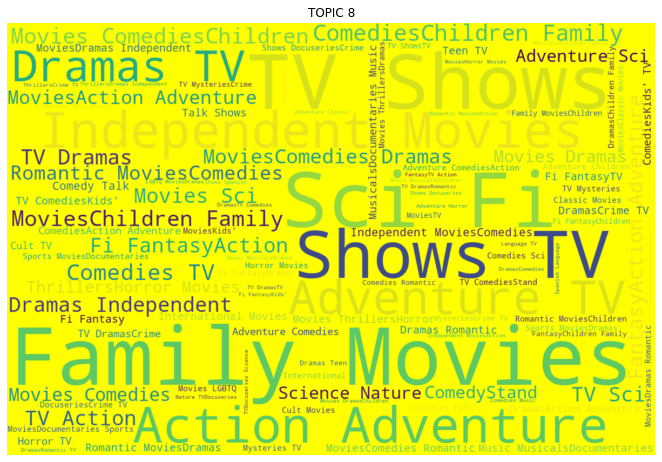

India


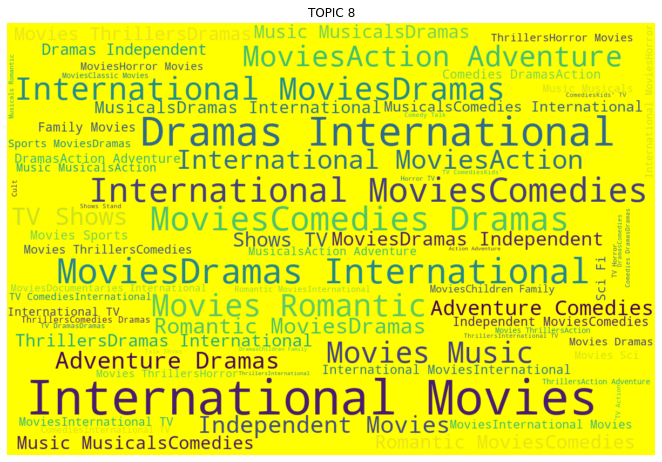

United Kingdom


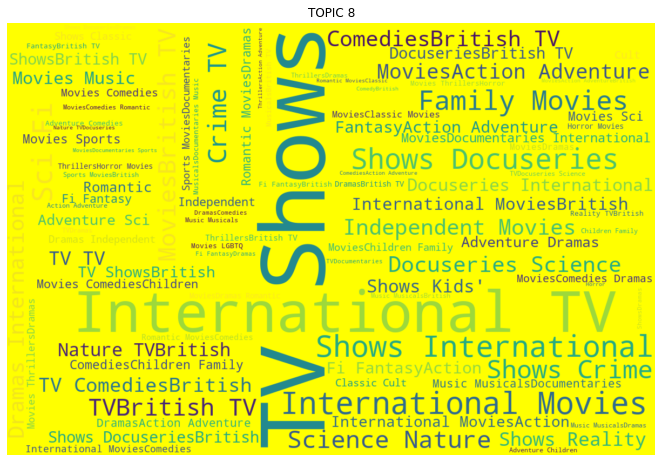

nuknown


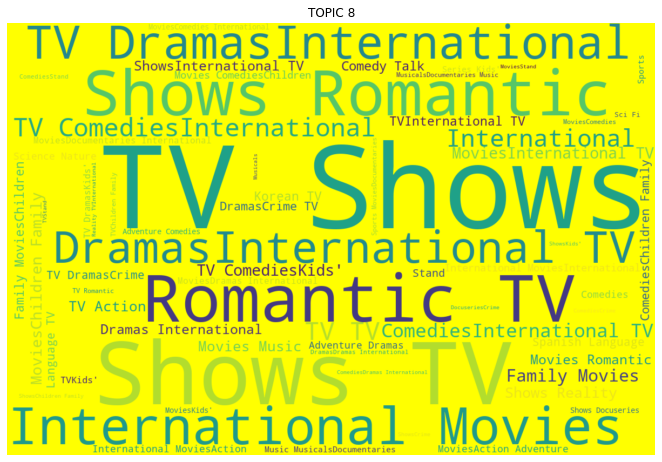

Canada


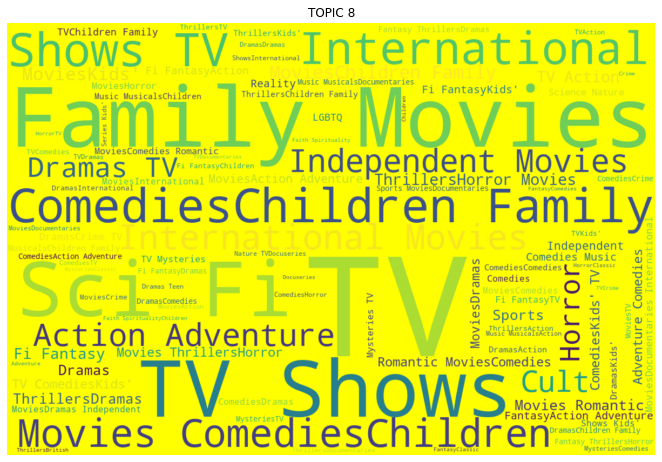

France


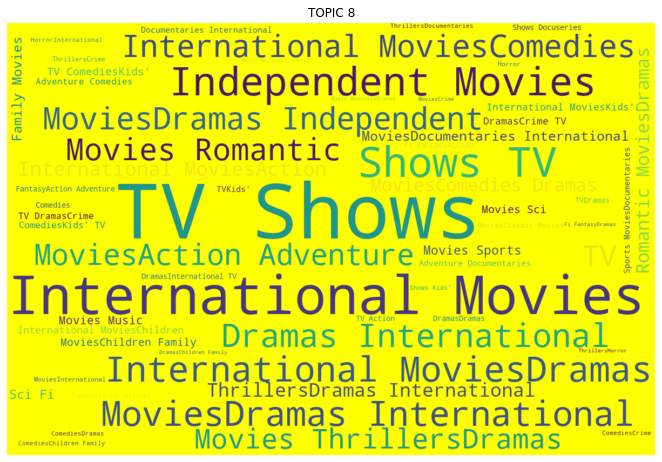

Japan


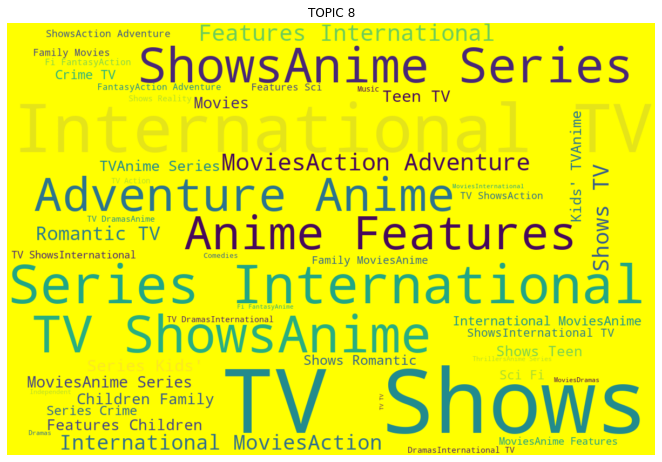

Spain


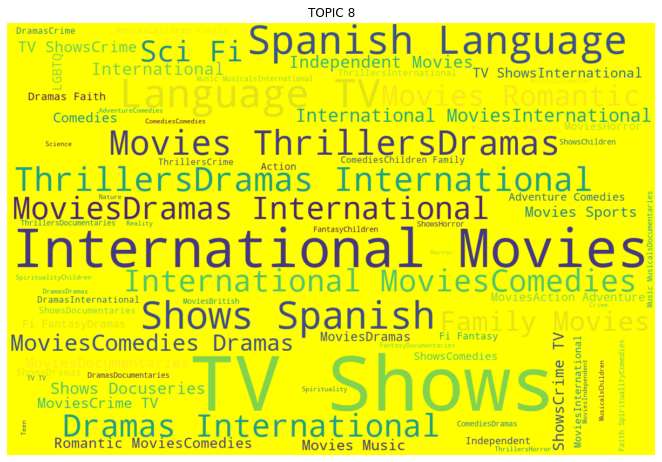

Germany


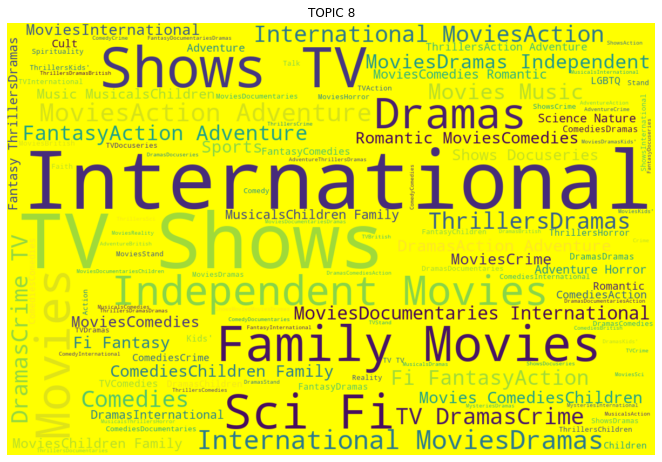

South Korea


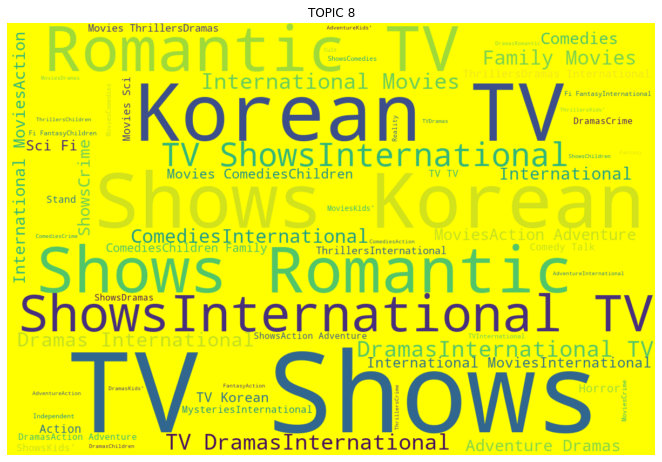

China


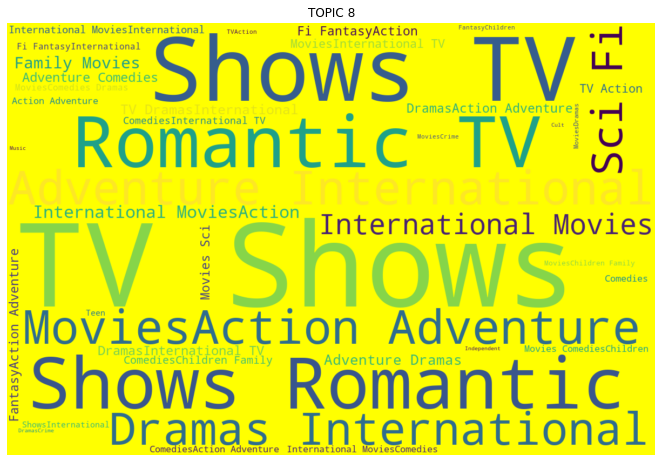

Australia


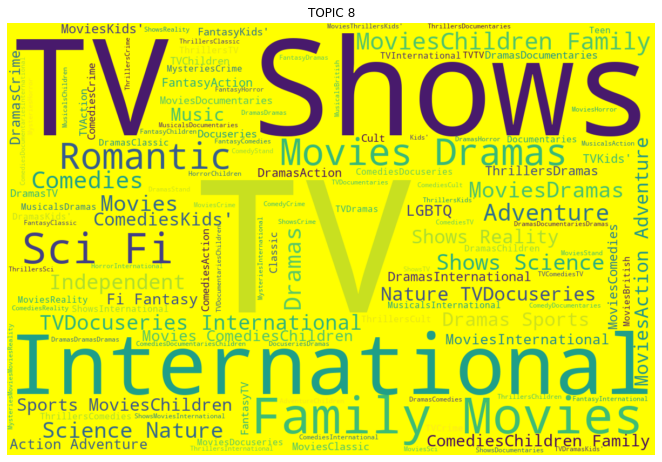

Mexico


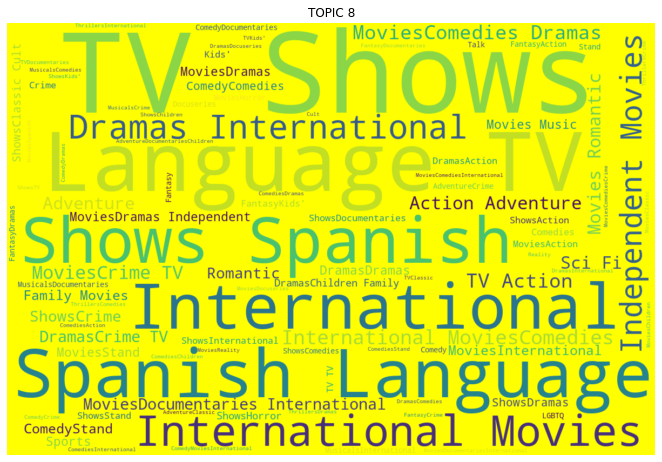

Turkey


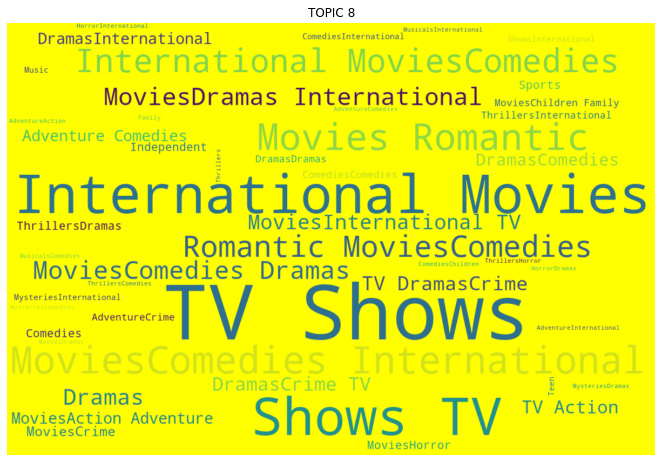

Egypt


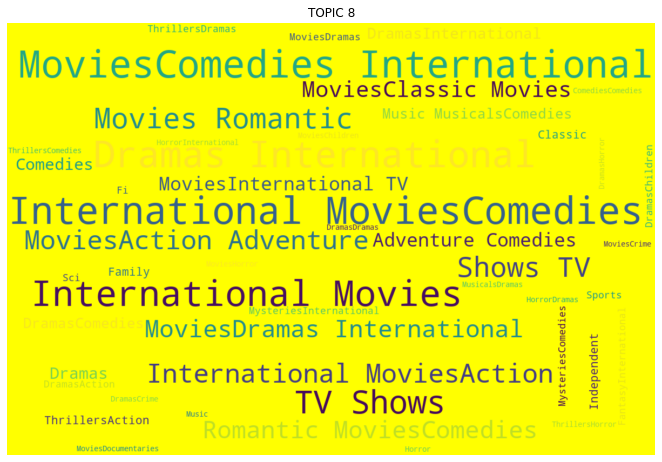

Hong Kong


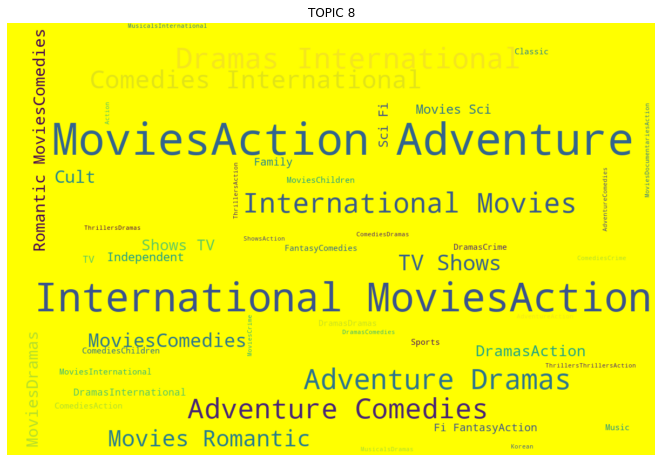

Taiwan


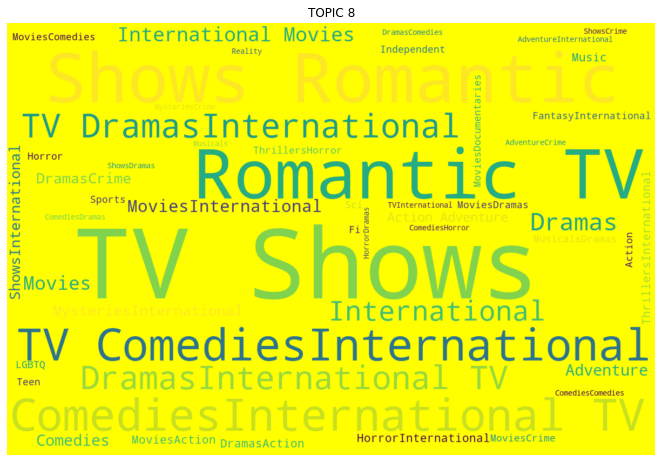

Brazil


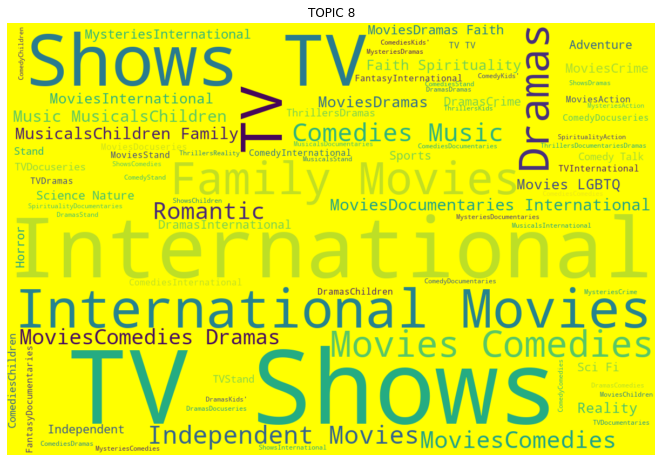

Belgium


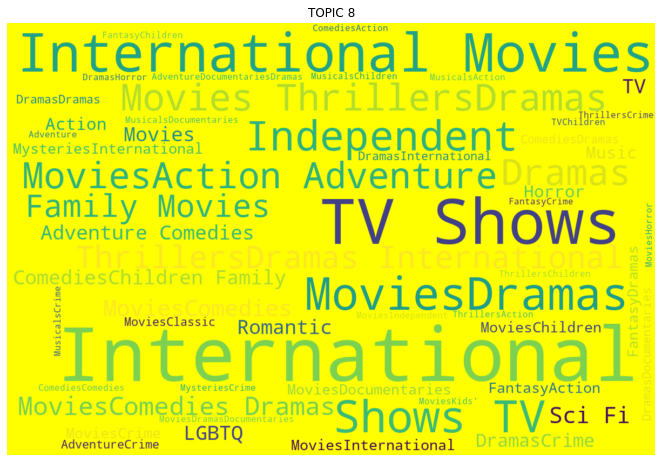

Indonesia


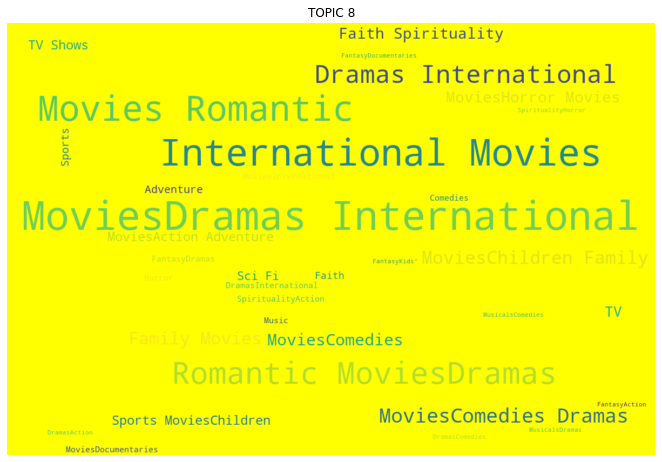

In [ ]:
# Applying word cloud function that we defined above using for loop
from wordcloud import WordCloud
for i in list_top20_countries:
    print(i)
    word_count_country(i)

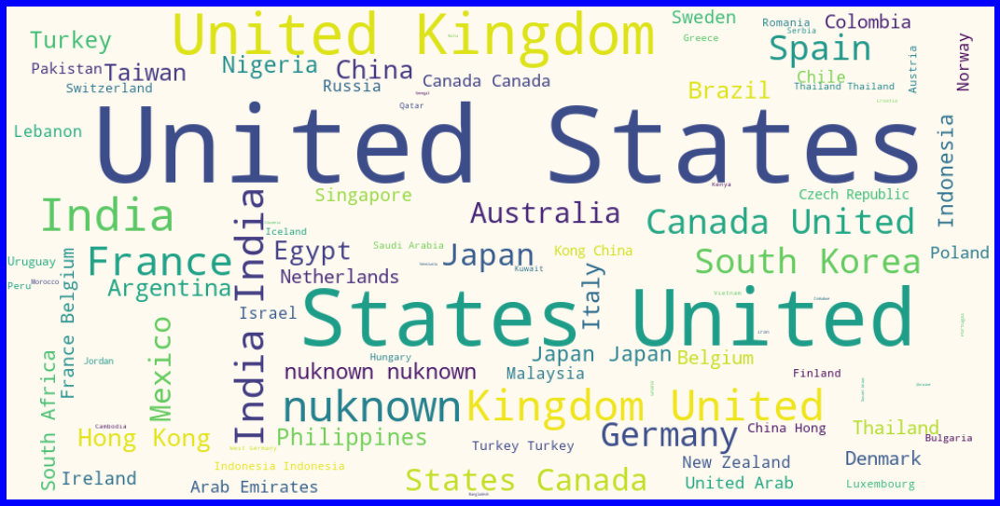

In [ ]:
fig = plt.figure(figsize=(15,8),facecolor = 'b',edgecolor = 'r')
wordcloud = WordCloud(background_color='floralwhite',width=1000, height=500 ).generate(" ".join(data.country))
plt.imshow(wordcloud,interpolation ='bilinear')
plt.axis('off')
plt.tight_layout()
plt.savefig('country.png')
plt.show()

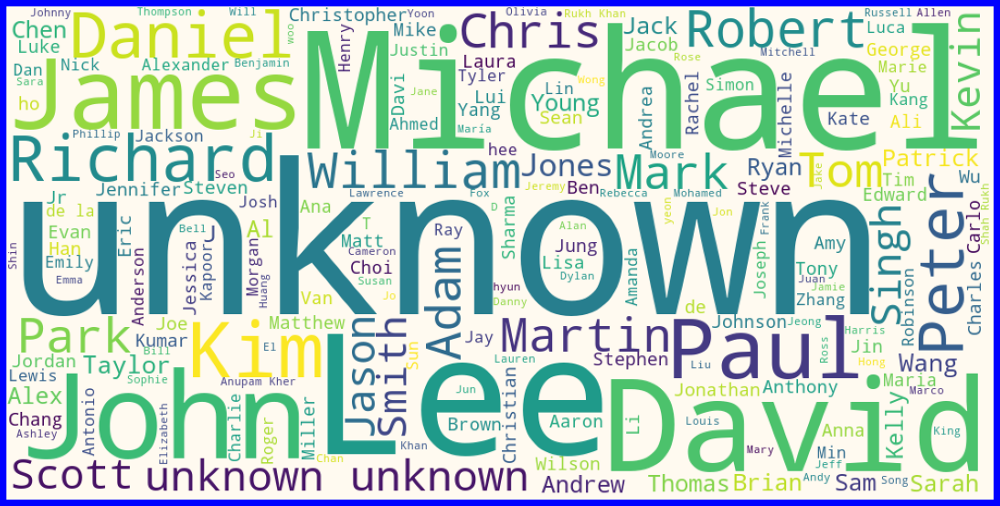

In [ ]:
text = data['cast']
wordcloud = WordCloud(width = 1000,height = 500,background_color = 'floralwhite').generate(" ".join(data.cast))
fig = plt.figure(figsize = (15,8),facecolor = 'b',edgecolor = 'k',)
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

# K-MEANS clustering

### Silhouette score

For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.56376469026194
For n_clusters = 6 The average silhouette_score is : 0.4504666294372765
For n_clusters = 7 The average silhouette_score is : 0.39092211029930857
For n_clusters = 8 The average silhouette_score is : 0.3314853899648912
For n_clusters = 9 The average silhouette_score is : 0.3349898818697859
For n_clusters = 10 The average silhouette_score is : 0.3392920964838248
For n_clusters = 11 The average silhouette_score is : 0.3283894338895206
For n_clusters = 12 The average silhouette_score is : 0.3548847919125572
For n_clusters = 13 The average silhouette_score is : 0.35863998455907603
For n_clusters = 14 The average silhouette_score is : 0.3591478987980633
For n_clusters = 15 The average silhouette_score is : 0.363

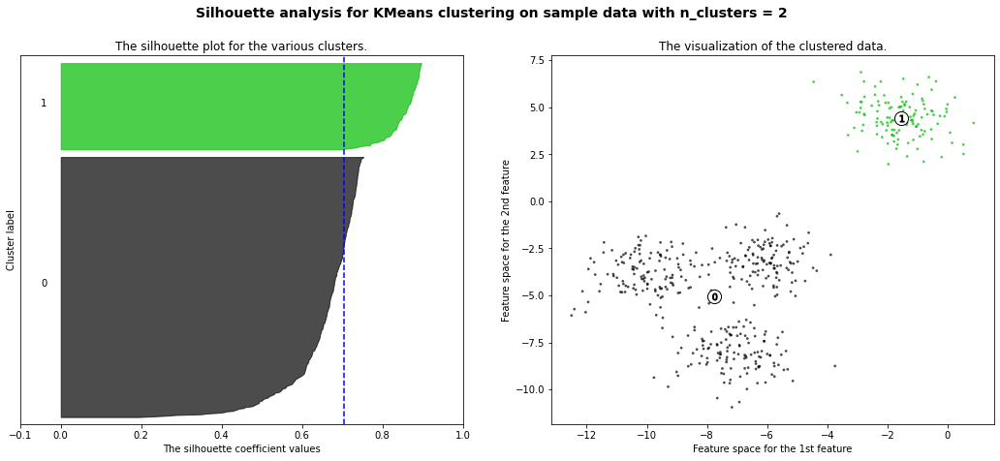

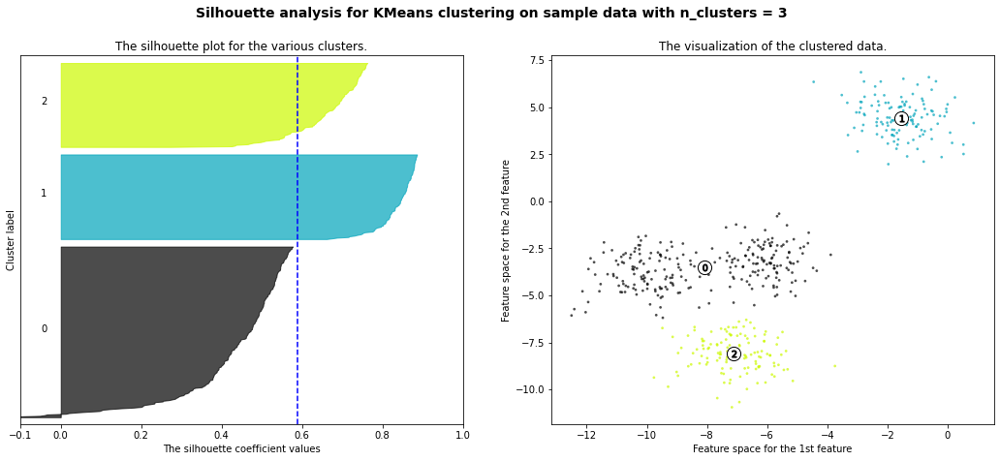

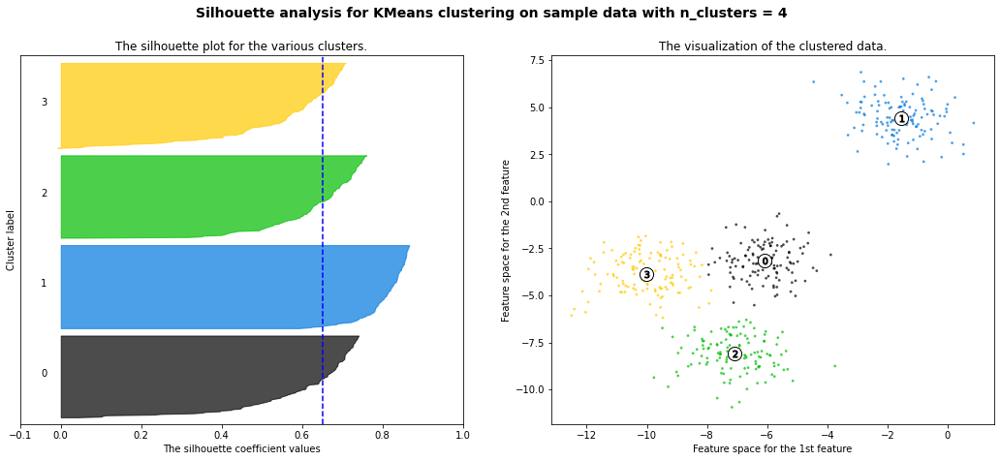

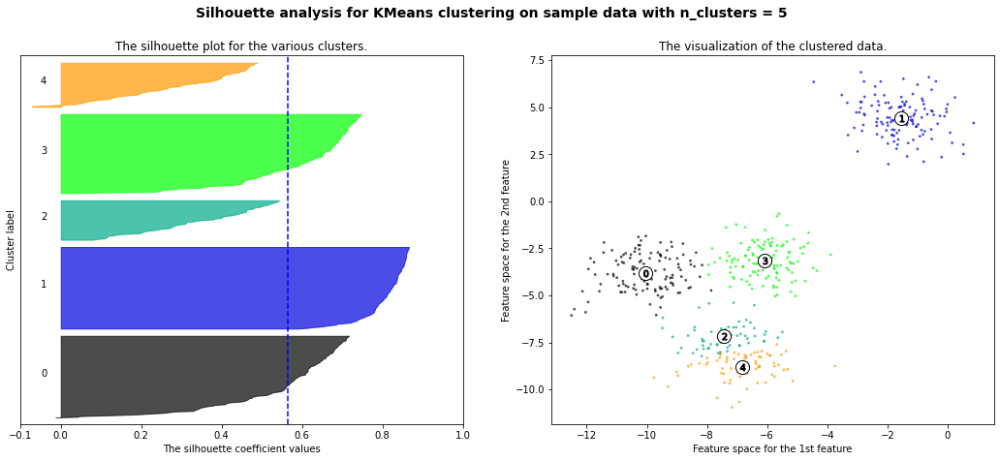

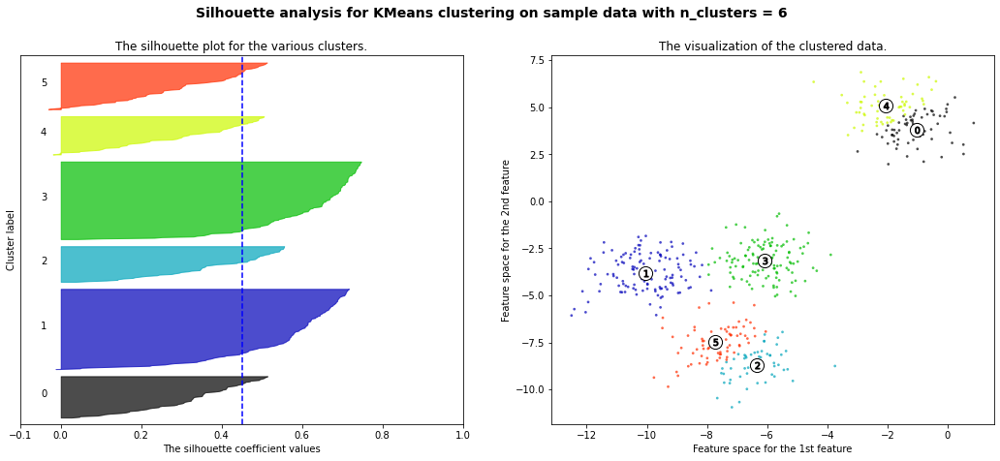

...

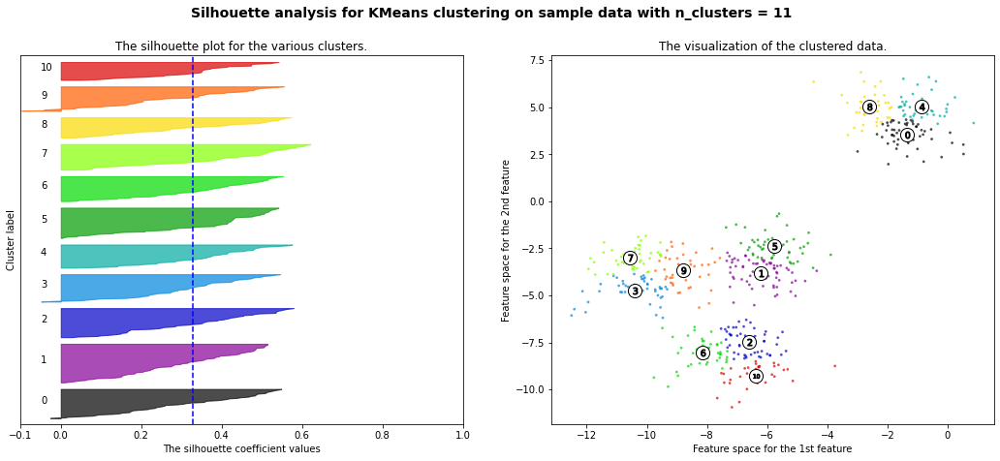

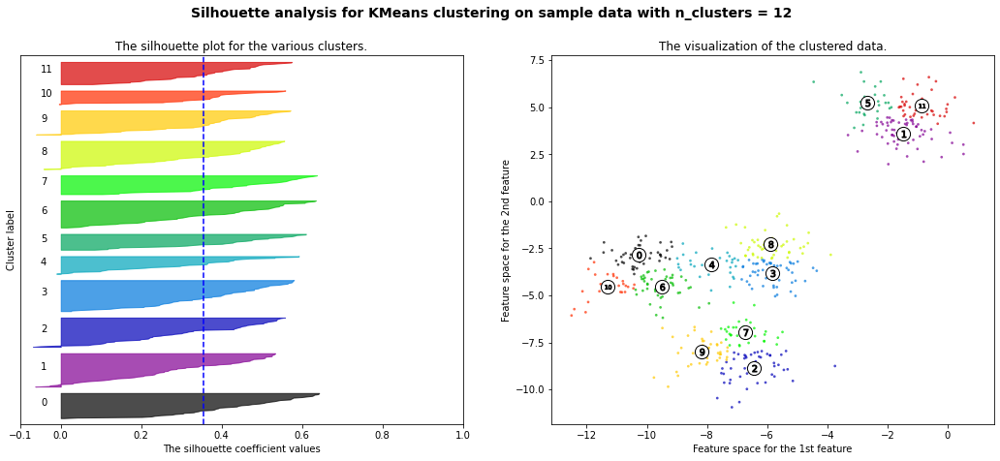

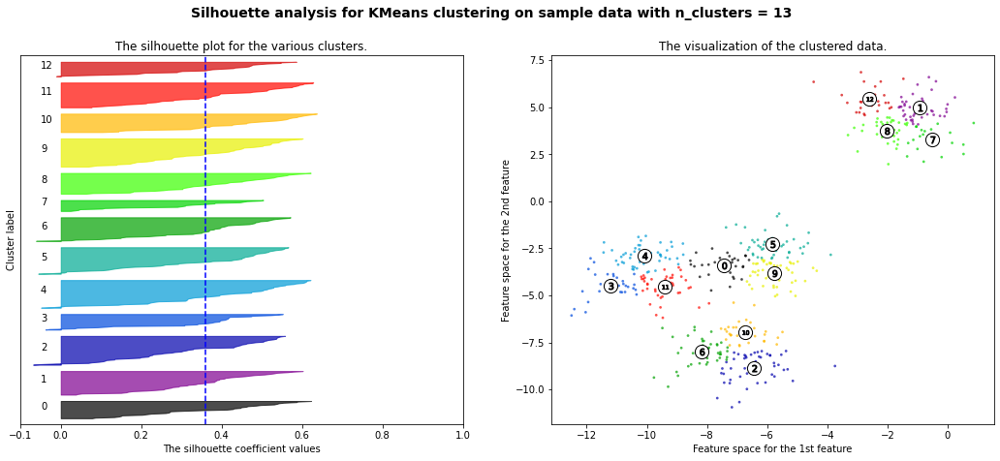

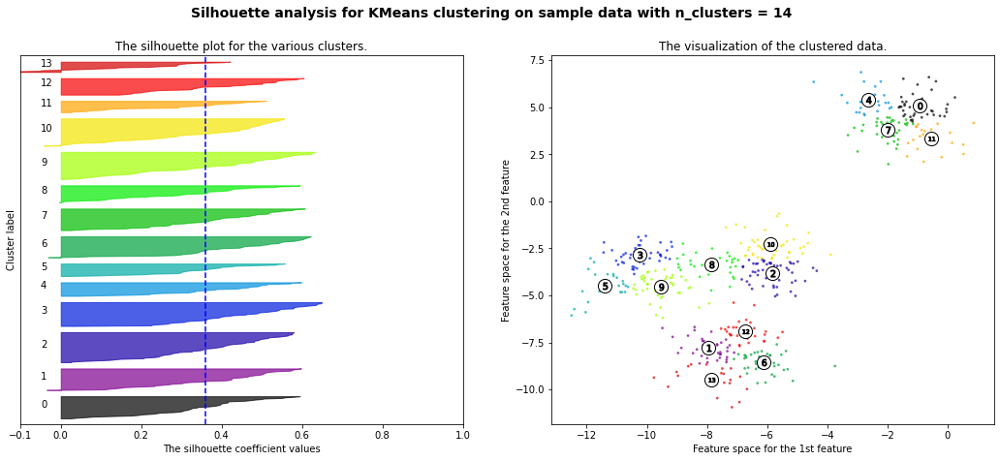

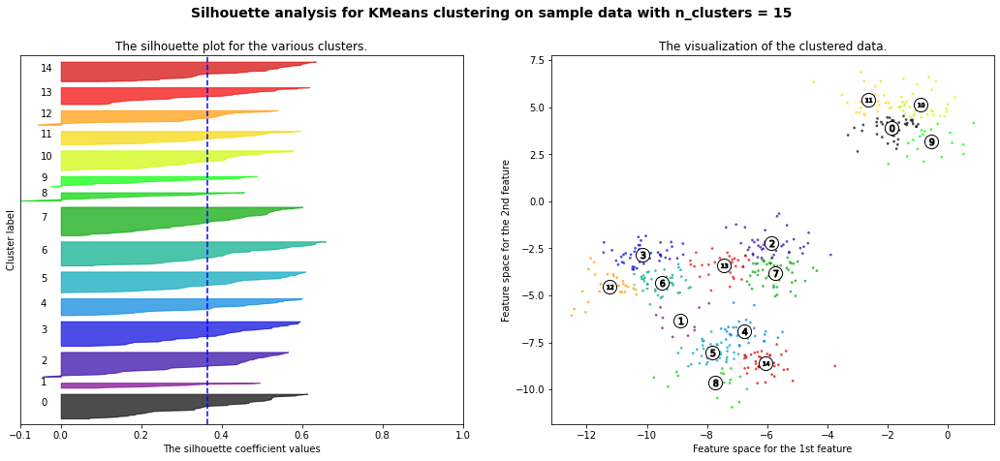

In [ ]:
# Generating the sample data from make_blobs
X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  cluster_std=1,
                  center_box=(-10.0, 10.0),
                  shuffle=True,
                  random_state=1)              #  For reproducibility

range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="blue", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")
    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

# Conclusion :

1.  Most films were released in the years 2018, 2019, and 2020.


2. The months of October, November, December and January had the largest number of films and television series released.

    1. We started by removing nan values and converting the Netflix added date to year, month, and day using date time format.

    2. For the clustering algorithm, we utilised type, director, nation, released year, genre, and year.

    3. The final model we used was k-means clustering, which consisted of 2,3,4,5,6 clusters. Score of silhoutte in k-measn clustering :

        n_clusters = 2 The average silhouette_score is : 07049787496083262

        n_clusters = 3 The average silhouette_score is : 05882004012129721

        n_clusters = 4 The average silhouette_score is : 06505186632729437

        n_clusters = 5 The average silhouette_score is : 0.56376469026194

        n_clusters = 6 The average silhouette_score is : 04504666294372765

1)There are about 70% movies and 30% TV shows on Netflix.    

2)Data set contains 7787 rows and 12 columns in that cast and director features contains large number of missing values so we can drop it and we have 10 features for the further implementation

3)The United States has the highest number of content on Netflix by a huge margin followed by India.

4)Raul Campos and Jan Sulter collectively have directed the most content on Netflix.

5)Anupam Kher has acted in the highest number of films on Netflix. Drama is the most popular genre followed by comedy.

6)More of the content is released in holiday season - October, November, December and January.

7)The number of releases have significantly increased after 2015 and have dropped in 2021 because of Covid 19.